In [1]:
# Устанавливаем библиотеку ultralytics
%pip install ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 41.3/41.3 kB 2.6 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_nccl_cu12-2.20.5-py3-none-manylinux2014_x86_64.

In [2]:
# Распаковываем архив с обучающей и валидационной выборками,
# а также файл с информацией о структуре каталогов с данными,
# количестве классов и метках
!unzip Dataset.zip

Archive:  Dataset.zip
   creating: dataset/
   creating: dataset/val/
   creating: dataset/val/images/
  inflating: dataset/val/images/IMG_8330.png  
  inflating: dataset/val/images/IMG_8334.png  
  inflating: dataset/val/images/IMG_8335.png  
  inflating: dataset/val/images/IMG_8338.png  
  inflating: dataset/val/images/IMG_8339.png  
  inflating: dataset/val/images/IMG_8340.png  
  inflating: dataset/val/images/IMG_8343.png  
  inflating: dataset/val/images/IMG_8345.png  
  inflating: dataset/val/images/IMG_8346.png  
  inflating: dataset/val/images/IMG_8347.png  
  inflating: dataset/val/images/IMG_8357.png  
  inflating: dataset/val/images/IMG_8363.png  
  inflating: dataset/val/images/IMG_8367.png  
  inflating: dataset/val/images/IMG_8370.png  
  inflating: dataset/val/images/IMG_8375.png  
  inflating: dataset/val/images/IMG_8376.png  
  inflating: dataset/val/images/IMG_8378.png  
  inflating: dataset/val/images/IMG_8390.png  
  inflating: dataset/val/images/IMG_8391.png  
  in

In [3]:
# Устанавливаем необходимые библиотеки
from google.colab.patches import cv2_imshow
from ultralytics import YOLO
import numpy as np
import cv2
import os

In [ ]:
# Загружаем модель YOLOv8s
base_model = YOLO("yolov8s.pt")

100%|██████████| 21.5M/21.5M [00:00<00:00, 207MB/s]


In [ ]:
# Обучаем модель с применением GPU
results = base_model.train(data=r"/content/data.yaml",
                      epochs=500,
                      batch=16,
                      imgsz=640,
                      device="cuda",
                      name="training",
                      seed=25,
                      plots=True)

Ultralytics YOLOv8.2.71 🚀 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/content/data.yaml, epochs=500, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=cuda, workers=8, project=None, name=training, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=25, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_box

100%|██████████| 755k/755k [00:00<00:00, 21.7MB/s]


Overriding model.yaml nc=80 with nc=4

                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     29056  ultralytics.nn.modules.block.C2f             [64, 64, 1, True]             
  3                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  4                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  5                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128, 256, 3, 2]              
  6                  -1  2    788480  ultralytics.nn.modules.block.C2f             [256, 256, 2, True]           
  7                  -1  1   1180672  ultralytics

100%|██████████| 6.25M/6.25M [00:00<00:00, 105MB/s]


AMP: checks passed ✅


train: Scanning /content/dataset/train/labels... 196 images, 0 backgrounds, 0 corrupt: 100%|██████████| 196/196 [00:00<00:00, 684.74it/s]

train: New cache created: /content/dataset/train/labels.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
val: Scanning /content/dataset/val/labels... 83 images, 0 backgrounds, 0 corrupt: 100%|██████████| 83/83 [00:00<00:00, 579.82it/s]

val: New cache created: /content/dataset/val/labels.cache


Plotting labels to runs/detect/training/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.00125, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/training
Starting training for 500 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/500      4.27G          3      7.945      2.214         10        640: 100%|██████████| 13/13 [00:07<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:04<00:00,  1.66s/it]

                   all         83        148       0.05     0.0172     0.0255    0.00763



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/500      4.33G      2.039      3.225      1.487         16        640: 100%|██████████| 13/13 [00:03<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.28it/s]

                   all         83        148      0.513      0.356      0.339      0.158



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/500       4.2G      1.721       2.45      1.342         10        640: 100%|██████████| 13/13 [00:03<00:00,  3.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.97it/s]

                   all         83        148      0.589      0.444      0.462      0.217



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/500      4.32G      1.692      2.009      1.328         12        640: 100%|██████████| 13/13 [00:04<00:00,  3.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.78it/s]

                   all         83        148      0.492      0.434      0.474      0.203



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/500      4.18G      1.677      1.728      1.267         16        640: 100%|██████████| 13/13 [00:03<00:00,  3.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.98it/s]

                   all         83        148      0.547      0.531      0.532      0.248



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/500       4.2G       1.64      1.513      1.341         11        640: 100%|██████████| 13/13 [00:05<00:00,  2.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.53it/s]

                   all         83        148      0.614       0.56      0.597      0.277



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/500      4.33G      1.751      1.548      1.318         11        640: 100%|██████████| 13/13 [00:03<00:00,  3.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.67it/s]

                   all         83        148      0.482      0.569      0.452      0.198



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/500      4.17G      1.664      1.573      1.279         15        640: 100%|██████████| 13/13 [00:03<00:00,  3.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.40it/s]

                   all         83        148      0.615       0.59      0.602       0.28



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/500      4.13G      1.687      1.412      1.367          7        640: 100%|██████████| 13/13 [00:04<00:00,  2.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.58it/s]

                   all         83        148      0.784      0.408      0.452      0.193



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/500      4.18G      1.693      1.294      1.357         17        640: 100%|██████████| 13/13 [00:03<00:00,  3.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.86it/s]

                   all         83        148      0.672      0.461      0.504      0.219



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/500      4.19G      1.615       1.42      1.306          4        640: 100%|██████████| 13/13 [00:04<00:00,  2.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.43it/s]

                   all         83        148       0.79      0.479      0.539      0.238



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/500      4.18G      1.681      1.394      1.372          3        640: 100%|██████████| 13/13 [00:03<00:00,  3.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.74it/s]

                   all         83        148      0.635      0.557      0.578      0.247



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/500      4.15G      1.553      1.178      1.255          7        640: 100%|██████████| 13/13 [00:03<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.26it/s]

                   all         83        148      0.698      0.624      0.678      0.332



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/500      4.18G      1.622      1.203      1.315         15        640: 100%|██████████| 13/13 [00:04<00:00,  2.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.51it/s]

                   all         83        148      0.727      0.751      0.791      0.411



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/500      4.17G      1.622      1.195      1.322         10        640: 100%|██████████| 13/13 [00:03<00:00,  3.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.84it/s]

                   all         83        148      0.665      0.595      0.575       0.27



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/500      4.18G      1.685      1.143      1.304          9        640: 100%|██████████| 13/13 [00:05<00:00,  2.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.43it/s]

                   all         83        148      0.774      0.577      0.611      0.284



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/500      4.13G      1.624      1.123      1.247          3        640: 100%|██████████| 13/13 [00:03<00:00,  3.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.72it/s]

                   all         83        148      0.812       0.65       0.73      0.368



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/500      4.18G      1.529      1.083      1.248          7        640: 100%|██████████| 13/13 [00:03<00:00,  3.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.00it/s]

                   all         83        148      0.598      0.584      0.631      0.323



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/500      4.16G      1.577      1.124      1.248         11        640: 100%|██████████| 13/13 [00:04<00:00,  2.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.57it/s]

                   all         83        148      0.773      0.635      0.699      0.335



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/500       4.2G      1.595       1.13      1.294          8        640: 100%|██████████| 13/13 [00:03<00:00,  3.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.77it/s]

                   all         83        148      0.773      0.652      0.704      0.333



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/500      4.13G      1.605      1.054       1.33          8        640: 100%|██████████| 13/13 [00:04<00:00,  2.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.38it/s]

                   all         83        148      0.806      0.642      0.735      0.339



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/500      4.18G      1.536      1.038      1.222          9        640: 100%|██████████| 13/13 [00:03<00:00,  3.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.86it/s]

                   all         83        148      0.816      0.724      0.816      0.417



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/500      4.17G      1.503      1.077      1.219         14        640: 100%|██████████| 13/13 [00:03<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.08it/s]

                   all         83        148      0.757       0.73      0.748       0.35



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/500      4.17G      1.498      1.068      1.203         15        640: 100%|██████████| 13/13 [00:05<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.70it/s]

                   all         83        148      0.777      0.686      0.791      0.419



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/500      4.13G      1.511     0.9755      1.262          7        640: 100%|██████████| 13/13 [00:03<00:00,  3.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.79it/s]


                   all         83        148      0.868      0.651      0.789      0.425

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/500      4.17G       1.45     0.9391      1.186          6        640: 100%|██████████| 13/13 [00:05<00:00,  2.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.44it/s]

                   all         83        148      0.806      0.585      0.693      0.348



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/500      4.17G       1.56      1.004      1.301          5        640: 100%|██████████| 13/13 [00:04<00:00,  2.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.82it/s]

                   all         83        148      0.859      0.792      0.871      0.455



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/500      4.15G       1.46     0.9574      1.222          5        640: 100%|██████████| 13/13 [00:03<00:00,  3.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.86it/s]

                   all         83        148      0.727      0.826      0.837      0.443



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/500      4.16G      1.447     0.8736       1.19         11        640: 100%|██████████| 13/13 [00:04<00:00,  2.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.31it/s]

                   all         83        148      0.831      0.688      0.784      0.403



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/500      4.18G       1.42     0.9437      1.192         12        640: 100%|██████████| 13/13 [00:03<00:00,  3.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.77it/s]

                   all         83        148      0.877      0.814      0.896      0.508



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/500      4.18G      1.392     0.8878      1.138          9        640: 100%|██████████| 13/13 [00:03<00:00,  3.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.74it/s]

                   all         83        148      0.868      0.846      0.894      0.493



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/500      4.15G      1.415     0.9667      1.231         11        640: 100%|██████████| 13/13 [00:04<00:00,  2.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.14it/s]

                   all         83        148      0.898      0.761      0.856      0.478



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/500      4.13G      1.397     0.8942      1.202         10        640: 100%|██████████| 13/13 [00:03<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.98it/s]


                   all         83        148        0.9      0.815       0.89      0.498

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/500      4.16G      1.398      0.889      1.191         10        640: 100%|██████████| 13/13 [00:04<00:00,  2.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.29it/s]

                   all         83        148      0.903      0.785      0.875      0.506



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/500      4.18G      1.437     0.9624      1.241          9        640: 100%|██████████| 13/13 [00:03<00:00,  3.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.73it/s]

                   all         83        148      0.879      0.849      0.906      0.532



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/500      4.18G      1.415     0.8799      1.155          7        640: 100%|██████████| 13/13 [00:03<00:00,  3.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.26it/s]

                   all         83        148      0.874      0.764      0.837      0.465



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/500      4.16G       1.42      0.899      1.162          8        640: 100%|██████████| 13/13 [00:05<00:00,  2.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.64it/s]

                   all         83        148      0.944      0.794      0.844      0.441



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/500      4.16G      1.533     0.9015      1.215         11        640: 100%|██████████| 13/13 [00:03<00:00,  3.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.82it/s]

                   all         83        148      0.826      0.733      0.745      0.402



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/500      4.18G      1.543     0.9724      1.243          8        640: 100%|██████████| 13/13 [00:04<00:00,  2.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.38it/s]

                   all         83        148      0.864      0.807       0.89      0.474



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/500      4.17G      1.489     0.8995      1.183          8        640: 100%|██████████| 13/13 [00:03<00:00,  3.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.63it/s]

                   all         83        148      0.866      0.747      0.838      0.415



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/500      4.13G      1.408     0.8698      1.157          8        640: 100%|██████████| 13/13 [00:03<00:00,  3.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.79it/s]

                   all         83        148      0.915      0.867      0.916      0.517



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/500      4.18G      1.323     0.8412      1.163          5        640: 100%|██████████| 13/13 [00:05<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.04it/s]

                   all         83        148      0.865      0.788      0.873      0.493



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/500      4.15G      1.279     0.8452      1.114         10        640: 100%|██████████| 13/13 [00:03<00:00,  3.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.04it/s]

                   all         83        148      0.913      0.865      0.911      0.516



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/500      4.17G      1.322     0.7915      1.107         10        640: 100%|██████████| 13/13 [00:03<00:00,  3.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.58it/s]

                   all         83        148      0.895      0.863      0.922      0.545



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/500      4.13G      1.323     0.8296      1.115          8        640: 100%|██████████| 13/13 [00:04<00:00,  3.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.05it/s]

                   all         83        148       0.88      0.864      0.919       0.55



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/500      4.17G      1.347     0.7875      1.111         18        640: 100%|██████████| 13/13 [00:05<00:00,  2.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.53it/s]

                   all         83        148      0.916      0.839      0.937      0.525



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/500      4.17G      1.382     0.8147      1.196          4        640: 100%|██████████| 13/13 [00:04<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.54it/s]

                   all         83        148      0.951      0.853      0.945       0.53



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/500      4.18G      1.375     0.7844      1.153         17        640: 100%|██████████| 13/13 [00:03<00:00,  3.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.12it/s]

                   all         83        148      0.928      0.799      0.898      0.505



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/500      4.16G      1.369       0.78      1.101         13        640: 100%|██████████| 13/13 [00:05<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.67it/s]

                   all         83        148       0.94       0.72      0.845       0.49



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/500      4.16G      1.337       0.79      1.145          9        640: 100%|██████████| 13/13 [00:03<00:00,  3.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.20it/s]

                   all         83        148      0.943       0.88      0.949      0.549



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/500      4.17G      1.328     0.7972      1.113          9        640: 100%|██████████| 13/13 [00:03<00:00,  3.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.93it/s]

                   all         83        148      0.951      0.905      0.948      0.547



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/500      4.15G        1.3     0.7749      1.117          6        640: 100%|██████████| 13/13 [00:04<00:00,  2.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.61it/s]

                   all         83        148      0.905      0.911      0.931      0.548



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/500      4.13G      1.332     0.7898      1.152         12        640: 100%|██████████| 13/13 [00:03<00:00,  3.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.09it/s]

                   all         83        148      0.873      0.927      0.929      0.542



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/500      4.17G      1.332      0.768      1.107          8        640: 100%|██████████| 13/13 [00:04<00:00,  2.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.35it/s]

                   all         83        148      0.916       0.88      0.917      0.533



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/500      4.17G      1.316     0.7376      1.139          7        640: 100%|██████████| 13/13 [00:03<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.81it/s]

                   all         83        148      0.921      0.847      0.908      0.539



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/500      4.16G       1.36     0.8109      1.182          4        640: 100%|██████████| 13/13 [00:03<00:00,  3.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.35it/s]

                   all         83        148      0.962      0.915       0.94      0.567



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/500      4.13G      1.302     0.7791      1.116          8        640: 100%|██████████| 13/13 [00:05<00:00,  2.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.40it/s]

                   all         83        148      0.928      0.897      0.954      0.557



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/500      4.18G      1.284     0.7824      1.117          9        640: 100%|██████████| 13/13 [00:03<00:00,  3.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.93it/s]

                   all         83        148      0.937       0.93       0.96      0.554



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/500      4.17G      1.282     0.8277      1.137         12        640: 100%|██████████| 13/13 [00:04<00:00,  2.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.42it/s]

                   all         83        148      0.906      0.862      0.937      0.551



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/500      4.17G      1.324     0.7756      1.122         14        640: 100%|██████████| 13/13 [00:03<00:00,  3.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.71it/s]

                   all         83        148      0.865      0.884      0.905      0.528



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/500      4.15G      1.261     0.7361      1.103          7        640: 100%|██████████| 13/13 [00:03<00:00,  3.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.25it/s]

                   all         83        148      0.915      0.819      0.898      0.492



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/500      4.16G      1.349     0.8048      1.148         12        640: 100%|██████████| 13/13 [00:04<00:00,  2.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.40it/s]

                   all         83        148       0.88      0.868       0.94      0.545



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/500      4.16G      1.213     0.7345      1.079         14        640: 100%|██████████| 13/13 [00:03<00:00,  3.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.92it/s]


                   all         83        148      0.948      0.885      0.946      0.554

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/500      4.15G      1.259     0.7513      1.118         11        640: 100%|██████████| 13/13 [00:05<00:00,  2.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.42it/s]

                   all         83        148      0.908      0.949      0.954      0.563



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/500      4.13G      1.337     0.7388      1.156          4        640: 100%|██████████| 13/13 [00:03<00:00,  3.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.73it/s]

                   all         83        148       0.92      0.946       0.97      0.586



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/500      4.16G       1.32     0.7494      1.144         14        640: 100%|██████████| 13/13 [00:05<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.35it/s]

                   all         83        148      0.959      0.917      0.973      0.579



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/500      4.17G      1.208     0.7533      1.087          6        640: 100%|██████████| 13/13 [00:03<00:00,  3.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.78it/s]

                   all         83        148      0.968      0.898      0.961       0.59



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/500      4.18G      1.239     0.7198      1.103          9        640: 100%|██████████| 13/13 [00:03<00:00,  3.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.81it/s]

                   all         83        148      0.952      0.901      0.945        0.6



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/500      4.13G      1.247     0.7171      1.107         11        640: 100%|██████████| 13/13 [00:05<00:00,  2.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.79it/s]

                   all         83        148      0.935      0.895      0.953       0.58



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/500      4.18G      1.246     0.7078      1.087         18        640: 100%|██████████| 13/13 [00:03<00:00,  3.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.76it/s]

                   all         83        148      0.913      0.887       0.95       0.58



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/500      4.15G      1.269     0.7405       1.13         15        640: 100%|██████████| 13/13 [00:04<00:00,  2.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.44it/s]

                   all         83        148      0.945       0.91      0.971      0.567



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/500      4.18G      1.252      0.754      1.101         14        640: 100%|██████████| 13/13 [00:03<00:00,  3.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.75it/s]

                   all         83        148      0.916      0.869      0.946      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/500      4.13G      1.205     0.7338      1.101         13        640: 100%|██████████| 13/13 [00:03<00:00,  3.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.03it/s]

                   all         83        148      0.972      0.933      0.984      0.553



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/500      4.19G       1.21     0.6883      1.078         11        640: 100%|██████████| 13/13 [00:04<00:00,  2.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.09it/s]

                   all         83        148      0.945      0.875      0.947      0.562



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/500       4.2G      1.239     0.6766       1.07         10        640: 100%|██████████| 13/13 [00:03<00:00,  3.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.84it/s]

                   all         83        148      0.941      0.904      0.962      0.569



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/500      4.15G      1.209     0.6776       1.12          6        640: 100%|██████████| 13/13 [00:05<00:00,  2.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.52it/s]

                   all         83        148      0.915      0.924       0.96      0.566



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/500      4.13G      1.244     0.7239      1.131          6        640: 100%|██████████| 13/13 [00:03<00:00,  3.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.58it/s]


                   all         83        148      0.946      0.966      0.977      0.575

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/500      4.18G      1.238     0.6996      1.111          6        640: 100%|██████████| 13/13 [00:03<00:00,  3.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.05it/s]

                   all         83        148      0.937      0.926      0.968      0.565



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/500       4.2G      1.183     0.7002      1.076          5        640: 100%|██████████| 13/13 [00:04<00:00,  2.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.56it/s]

                   all         83        148      0.976      0.921      0.986      0.586



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/500      4.18G       1.22     0.6524       1.09         10        640: 100%|██████████| 13/13 [00:03<00:00,  3.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.07it/s]

                   all         83        148      0.952      0.962      0.983      0.562



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/500      4.17G       1.25     0.7023      1.111          9        640: 100%|██████████| 13/13 [00:04<00:00,  2.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.41it/s]

                   all         83        148      0.956      0.949      0.974       0.56



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/500      4.18G      1.172     0.6562      1.046          9        640: 100%|██████████| 13/13 [00:03<00:00,  3.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.05it/s]

                   all         83        148      0.952      0.956      0.978       0.58



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/500      4.19G      1.212     0.6781        1.1         19        640: 100%|██████████| 13/13 [00:03<00:00,  3.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.63it/s]

                   all         83        148      0.944      0.955      0.974      0.592



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/500      4.18G       1.24      0.736      1.136         10        640: 100%|██████████| 13/13 [00:05<00:00,  2.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.18it/s]

                   all         83        148      0.935      0.944      0.972      0.587



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/500      4.13G      1.313      0.742       1.14         13        640: 100%|██████████| 13/13 [00:04<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.55it/s]

                   all         83        148      0.941       0.93      0.966      0.558



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/500      4.16G      1.263     0.7241      1.071         12        640: 100%|██████████| 13/13 [00:05<00:00,  2.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.37it/s]

                   all         83        148      0.926      0.937       0.97       0.58



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/500      4.18G      1.216     0.7129      1.115         11        640: 100%|██████████| 13/13 [00:03<00:00,  3.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.91it/s]

                   all         83        148      0.946      0.916      0.969      0.563



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/500      4.18G      1.198     0.7034      1.059         11        640: 100%|██████████| 13/13 [00:03<00:00,  3.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.89it/s]

                   all         83        148      0.928      0.896      0.967      0.571



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/500      4.13G      1.189     0.6584      1.051          8        640: 100%|██████████| 13/13 [00:05<00:00,  2.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.61it/s]

                   all         83        148      0.925      0.935      0.973      0.571



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/500      4.18G       1.21     0.6675      1.058          6        640: 100%|██████████| 13/13 [00:03<00:00,  3.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.68it/s]

                   all         83        148      0.955      0.903      0.961      0.572



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/500      4.17G      1.237     0.7025      1.114         14        640: 100%|██████████| 13/13 [00:04<00:00,  3.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.34it/s]

                   all         83        148      0.928      0.956      0.965       0.58



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/500      4.17G      1.124     0.6391      1.053          5        640: 100%|██████████| 13/13 [00:03<00:00,  3.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.64it/s]

                   all         83        148      0.949      0.901      0.973      0.557



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/500      4.13G      1.194     0.6734      1.064          6        640: 100%|██████████| 13/13 [00:03<00:00,  3.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.37it/s]

                   all         83        148      0.925      0.945      0.962      0.523



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/500      4.18G      1.208     0.6601      1.056         14        640: 100%|██████████| 13/13 [00:05<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.57it/s]

                   all         83        148      0.917       0.96      0.976      0.557



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/500       4.2G      1.133     0.6568      1.048         11        640: 100%|██████████| 13/13 [00:03<00:00,  3.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.71it/s]

                   all         83        148       0.97      0.919      0.978      0.583



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/500      4.18G      1.199     0.6541      1.086          7        640: 100%|██████████| 13/13 [00:03<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.60it/s]

                   all         83        148      0.958      0.932      0.967      0.594



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/500      4.13G      1.157     0.6435      1.065         15        640: 100%|██████████| 13/13 [00:04<00:00,  3.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.82it/s]

                   all         83        148      0.931      0.898      0.964       0.57



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/500      4.18G      1.063     0.6335      1.046          9        640: 100%|██████████| 13/13 [00:03<00:00,  3.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.92it/s]

                   all         83        148      0.936      0.931       0.95      0.606



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/500      4.15G      1.163     0.6585      1.079          8        640: 100%|██████████| 13/13 [00:05<00:00,  2.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.77it/s]

                   all         83        148       0.93      0.962       0.97       0.58



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/500      4.17G      1.105     0.6254      1.028         12        640: 100%|██████████| 13/13 [00:03<00:00,  3.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.68it/s]

                   all         83        148      0.935        0.9      0.955      0.548



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    101/500      4.13G      1.109     0.6339      1.075          9        640: 100%|██████████| 13/13 [00:03<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.85it/s]

                   all         83        148      0.953      0.926      0.976      0.547



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    102/500      4.18G      1.136     0.6708      1.069          7        640: 100%|██████████| 13/13 [00:04<00:00,  2.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.53it/s]

                   all         83        148      0.979      0.946       0.98       0.58



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    103/500      4.17G      1.192      0.681      1.089         12        640: 100%|██████████| 13/13 [00:03<00:00,  3.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.72it/s]

                   all         83        148       0.95       0.89       0.96      0.562



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    104/500      4.17G      1.145       0.64      1.043         16        640: 100%|██████████| 13/13 [00:05<00:00,  2.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.42it/s]

                   all         83        148       0.97      0.947      0.968      0.565



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    105/500      4.13G      1.135     0.6277      1.064          8        640: 100%|██████████| 13/13 [00:05<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.55it/s]

                   all         83        148      0.929      0.906      0.955      0.559



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    106/500      4.19G      1.174     0.6533      1.052         14        640: 100%|██████████| 13/13 [00:05<00:00,  2.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.48it/s]

                   all         83        148      0.925      0.896      0.923      0.535



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    107/500      4.18G      1.227      0.661      1.077         13        640: 100%|██████████| 13/13 [00:03<00:00,  3.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.59it/s]

                   all         83        148      0.959      0.908      0.957      0.581



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    108/500      4.17G      1.208     0.6796      1.074          4        640: 100%|██████████| 13/13 [00:03<00:00,  3.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.09it/s]

                   all         83        148      0.961      0.945      0.972      0.581



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    109/500      4.13G      1.119     0.5983      1.014         13        640: 100%|██████████| 13/13 [00:05<00:00,  2.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.81it/s]

                   all         83        148      0.956       0.92      0.963      0.612



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    110/500      4.18G      1.143     0.6311      1.071         16        640: 100%|██████████| 13/13 [00:03<00:00,  3.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.83it/s]

                   all         83        148      0.963      0.943      0.975       0.61



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    111/500       4.2G      1.099      0.602      1.026          6        640: 100%|██████████| 13/13 [00:04<00:00,  3.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.35it/s]

                   all         83        148      0.968      0.944      0.976      0.598



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    112/500      4.18G      1.083     0.6164       1.02         13        640: 100%|██████████| 13/13 [00:03<00:00,  3.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.17it/s]

                   all         83        148      0.946      0.907      0.954      0.589



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    113/500      4.16G        1.1     0.6109      1.052          7        640: 100%|██████████| 13/13 [00:03<00:00,  3.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.62it/s]

                   all         83        148      0.955      0.952      0.974      0.564



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    114/500      4.17G      1.149     0.6529      1.075          7        640: 100%|██████████| 13/13 [00:05<00:00,  2.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.26it/s]

                   all         83        148      0.958      0.935      0.971      0.577



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    115/500      4.19G      1.153     0.6316      1.035         10        640: 100%|██████████| 13/13 [00:03<00:00,  3.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.99it/s]

                   all         83        148      0.951      0.963      0.981      0.589



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    116/500      4.15G      1.093     0.6265      1.039          6        640: 100%|██████████| 13/13 [00:03<00:00,  3.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.33it/s]

                   all         83        148      0.962      0.899      0.946      0.587



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    117/500      4.13G       1.12     0.6511       1.09          8        640: 100%|██████████| 13/13 [00:04<00:00,  2.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.88it/s]

                   all         83        148       0.93      0.926      0.957      0.561



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    118/500      4.16G      1.075     0.6051      1.021         12        640: 100%|██████████| 13/13 [00:03<00:00,  3.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.15it/s]

                   all         83        148      0.948      0.923      0.961      0.566



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    119/500      4.17G      1.134     0.6313       1.06          8        640: 100%|██████████| 13/13 [00:05<00:00,  2.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.44it/s]

                   all         83        148      0.949      0.945      0.961      0.593



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    120/500      4.18G      1.023     0.5877      1.032          7        640: 100%|██████████| 13/13 [00:03<00:00,  3.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.59it/s]

                   all         83        148      0.928      0.923      0.956      0.588



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    121/500      4.13G      1.107     0.6182      1.015          5        640: 100%|██████████| 13/13 [00:03<00:00,  3.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.77it/s]

                   all         83        148       0.93      0.922      0.957       0.59



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    122/500      4.16G      1.043     0.5779      1.016          9        640: 100%|██████████| 13/13 [00:04<00:00,  2.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.73it/s]

                   all         83        148      0.957      0.923       0.98      0.602



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    123/500      4.17G      1.037     0.5856      1.012          7        640: 100%|██████████| 13/13 [00:03<00:00,  3.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.47it/s]

                   all         83        148      0.984      0.935      0.976       0.61



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    124/500       4.2G      1.055     0.5658      1.017         11        640: 100%|██████████| 13/13 [00:04<00:00,  2.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.53it/s]

                   all         83        148      0.924      0.954      0.966      0.583



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    125/500      4.16G      1.067     0.6003      1.009         11        640: 100%|██████████| 13/13 [00:05<00:00,  2.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.20it/s]

                   all         83        148      0.954      0.934      0.962      0.584



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    126/500      4.18G      1.039     0.5929      1.002         14        640: 100%|██████████| 13/13 [00:03<00:00,  3.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.78it/s]

                   all         83        148      0.924      0.934      0.956      0.566



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    127/500       4.2G      1.098     0.5825       1.04         11        640: 100%|██████████| 13/13 [00:04<00:00,  3.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.56it/s]

                   all         83        148      0.938      0.966      0.965      0.573



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    128/500      4.19G      1.027     0.5818      1.038          3        640: 100%|██████████| 13/13 [00:03<00:00,  3.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.80it/s]

                   all         83        148      0.957       0.96      0.979      0.603



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    129/500      4.13G      1.099     0.5995      1.048         10        640: 100%|██████████| 13/13 [00:04<00:00,  2.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.39it/s]

                   all         83        148      0.949      0.941      0.964      0.589



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    130/500      4.18G      1.093      0.599      1.026          9        640: 100%|██████████| 13/13 [00:03<00:00,  3.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.90it/s]

                   all         83        148      0.942      0.939      0.966      0.582



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    131/500      4.17G      1.026     0.5913      1.013          5        640: 100%|██████████| 13/13 [00:03<00:00,  3.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.69it/s]

                   all         83        148      0.971      0.933      0.977      0.599



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    132/500      4.17G      1.037     0.5779      1.011          9        640: 100%|██████████| 13/13 [00:05<00:00,  2.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.86it/s]

                   all         83        148      0.955      0.914      0.967      0.561



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    133/500      4.13G      1.075     0.5871      1.005         16        640: 100%|██████████| 13/13 [00:03<00:00,  3.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.90it/s]

                   all         83        148      0.982      0.914      0.985      0.596



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    134/500      4.15G      1.064     0.5722      1.021         17        640: 100%|██████████| 13/13 [00:04<00:00,  2.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.36it/s]

                   all         83        148      0.861      0.898      0.908      0.549



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    135/500      4.17G      1.108     0.6341      1.031         16        640: 100%|██████████| 13/13 [00:03<00:00,  3.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.72it/s]

                   all         83        148      0.932       0.89      0.961      0.601



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    136/500      4.18G      1.129     0.5929      1.036         15        640: 100%|██████████| 13/13 [00:03<00:00,  3.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.24it/s]

                   all         83        148      0.958      0.952      0.982      0.611



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    137/500      4.13G      1.073     0.6329      1.064          6        640: 100%|██████████| 13/13 [00:04<00:00,  2.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.89it/s]

                   all         83        148      0.965      0.957      0.981        0.6



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    138/500      4.18G      1.128        0.6      1.064         14        640: 100%|██████████| 13/13 [00:03<00:00,  3.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.82it/s]

                   all         83        148      0.955      0.932      0.975      0.618



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    139/500      4.17G      1.098     0.6068      1.047          6        640: 100%|██████████| 13/13 [00:04<00:00,  3.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.44it/s]

                   all         83        148       0.95       0.95      0.985      0.608



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    140/500      4.22G       1.14     0.6079      1.054         10        640: 100%|██████████| 13/13 [00:03<00:00,  3.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.89it/s]

                   all         83        148      0.971      0.942      0.986      0.605



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    141/500      4.15G      1.101     0.6027      1.017          9        640: 100%|██████████| 13/13 [00:03<00:00,  3.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.15it/s]

                   all         83        148       0.94      0.935      0.971      0.605



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    142/500      4.18G      1.087     0.5915      1.012          7        640: 100%|██████████| 13/13 [00:04<00:00,  2.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.67it/s]

                   all         83        148      0.957      0.944      0.986      0.595



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    143/500      4.18G       1.09       0.61      1.053          8        640: 100%|██████████| 13/13 [00:03<00:00,  3.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.90it/s]

                   all         83        148      0.944      0.956      0.986      0.615



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    144/500      4.15G     0.9882     0.5705      1.006         13        640: 100%|██████████| 13/13 [00:04<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.60it/s]

                   all         83        148      0.971      0.951      0.972      0.616



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    145/500      4.13G     0.9856     0.5449     0.9856         18        640: 100%|██████████| 13/13 [00:06<00:00,  2.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.43it/s]

                   all         83        148      0.962      0.946      0.966      0.613



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    146/500      4.18G     0.9465     0.5634      1.045          6        640: 100%|██████████| 13/13 [00:03<00:00,  3.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.78it/s]

                   all         83        148      0.958      0.923      0.962      0.599



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    147/500      4.18G     0.9586      0.534      0.993          7        640: 100%|██████████| 13/13 [00:05<00:00,  2.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.85it/s]

                   all         83        148      0.952      0.948      0.967      0.595



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    148/500      4.17G      1.031     0.5412      1.023          8        640: 100%|██████████| 13/13 [00:03<00:00,  3.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.49it/s]

                   all         83        148      0.978      0.944      0.976      0.605



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    149/500      4.13G       1.06     0.5636     0.9854          8        640: 100%|██████████| 13/13 [00:03<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.76it/s]

                   all         83        148      0.954       0.96      0.965      0.577



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    150/500      4.18G       1.08     0.6015      1.021          5        640: 100%|██████████| 13/13 [00:04<00:00,  2.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.63it/s]

                   all         83        148      0.962      0.935      0.963      0.592



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    151/500      4.16G       1.06      0.596      1.029          9        640: 100%|██████████| 13/13 [00:03<00:00,  3.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.47it/s]

                   all         83        148      0.946      0.959       0.97      0.594



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    152/500       4.2G      1.022     0.5765      1.001         12        640: 100%|██████████| 13/13 [00:04<00:00,  2.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.40it/s]

                   all         83        148      0.953      0.962      0.978       0.62



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    153/500      4.14G     0.9905     0.5572      1.014          8        640: 100%|██████████| 13/13 [00:03<00:00,  3.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.01it/s]

                   all         83        148      0.899      0.934      0.946      0.586



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    154/500      4.19G     0.9822     0.5615     0.9932          3        640: 100%|██████████| 13/13 [00:03<00:00,  3.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.99it/s]

                   all         83        148       0.96       0.92      0.972      0.603



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    155/500      4.17G      1.003     0.5572     0.9942          6        640: 100%|██████████| 13/13 [00:05<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.38it/s]

                   all         83        148      0.961      0.955      0.978      0.605



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    156/500      4.17G      1.007     0.5789      1.013          9        640: 100%|██████████| 13/13 [00:03<00:00,  3.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  3.00it/s]

                   all         83        148      0.998      0.917      0.973      0.606



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    157/500      4.15G     0.9814     0.5584     0.9996         13        640: 100%|██████████| 13/13 [00:04<00:00,  2.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.37it/s]

                   all         83        148      0.957       0.95      0.968      0.602



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    158/500      4.18G     0.9708     0.5357     0.9636         11        640: 100%|██████████| 13/13 [00:03<00:00,  3.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.51it/s]

                   all         83        148      0.948      0.951      0.959      0.596



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    159/500      4.17G     0.9832     0.5413     0.9829         10        640: 100%|██████████| 13/13 [00:03<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.82it/s]

                   all         83        148      0.949      0.934      0.965      0.604



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    160/500      4.17G       1.01     0.5476     0.9835          9        640: 100%|██████████| 13/13 [00:05<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.07it/s]

                   all         83        148       0.96      0.943      0.963      0.591



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    161/500      4.13G      1.021     0.5585      1.015         12        640: 100%|██████████| 13/13 [00:03<00:00,  3.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.66it/s]

                   all         83        148      0.946      0.933      0.963      0.599



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    162/500      4.18G      1.022     0.5545      1.013          6        640: 100%|██████████| 13/13 [00:03<00:00,  3.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.80it/s]

                   all         83        148      0.943      0.961       0.98      0.598



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    163/500      4.17G     0.9908     0.5559     0.9893         10        640: 100%|██████████| 13/13 [00:04<00:00,  3.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.63it/s]

                   all         83        148      0.948      0.934      0.958      0.591



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    164/500      4.19G      1.045     0.5571      1.004          7        640: 100%|██████████| 13/13 [00:04<00:00,  2.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.46it/s]

                   all         83        148      0.954      0.946      0.971       0.59



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    165/500      4.15G      1.006     0.5624     0.9719         22        640: 100%|██████████| 13/13 [00:05<00:00,  2.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.14it/s]

                   all         83        148      0.932      0.945      0.968      0.581



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    166/500      4.16G     0.9563     0.5457     0.9989         10        640: 100%|██████████| 13/13 [00:03<00:00,  3.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.71it/s]

                   all         83        148      0.931      0.859      0.951      0.574



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    167/500      4.17G     0.9761      0.558      1.023         10        640: 100%|██████████| 13/13 [00:03<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.48it/s]

                   all         83        148       0.96      0.919      0.976       0.59



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    168/500      4.15G      1.008     0.5522     0.9894         10        640: 100%|██████████| 13/13 [00:03<00:00,  3.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.02it/s]


                   all         83        148      0.954      0.951      0.962      0.559

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    169/500      4.13G     0.9714     0.5347     0.9622         10        640: 100%|██████████| 13/13 [00:03<00:00,  3.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.93it/s]

                   all         83        148       0.97      0.951      0.979      0.588



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    170/500      4.18G      1.034      0.544     0.9997          7        640: 100%|██████████| 13/13 [00:05<00:00,  2.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.15it/s]

                   all         83        148      0.989      0.921      0.981      0.602



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    171/500      4.17G     0.9949     0.5601      1.007         10        640: 100%|██████████| 13/13 [00:03<00:00,  3.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.84it/s]

                   all         83        148      0.949      0.936      0.971      0.587



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    172/500      4.17G     0.9719     0.5349      0.963         18        640: 100%|██████████| 13/13 [00:04<00:00,  3.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.43it/s]

                   all         83        148      0.963      0.946      0.972      0.605



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    173/500      4.13G      1.012     0.5603      0.997          6        640: 100%|██████████| 13/13 [00:04<00:00,  3.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.73it/s]

                   all         83        148      0.961      0.956      0.984      0.607



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    174/500      4.17G     0.9825      0.549     0.9605          4        640: 100%|██████████| 13/13 [00:03<00:00,  3.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.72it/s]

                   all         83        148      0.959      0.942      0.973      0.602



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    175/500      4.15G     0.9715     0.5828      1.001         13        640: 100%|██████████| 13/13 [00:05<00:00,  2.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.05it/s]

                   all         83        148      0.988       0.93      0.979      0.614



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    176/500      4.18G     0.9825     0.5975     0.9934          8        640: 100%|██████████| 13/13 [00:03<00:00,  3.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.75it/s]

                   all         83        148       0.95      0.918      0.959        0.6



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    177/500      4.13G      0.973     0.5591      0.988          7        640: 100%|██████████| 13/13 [00:03<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.82it/s]

                   all         83        148      0.954      0.857      0.942      0.561



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    178/500      4.18G     0.9542      0.517     0.9625          8        640: 100%|██████████| 13/13 [00:03<00:00,  3.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.69it/s]

                   all         83        148      0.952      0.955      0.981      0.577



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    179/500       4.2G     0.9256     0.5194     0.9561         12        640: 100%|██████████| 13/13 [00:03<00:00,  3.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.97it/s]

                   all         83        148      0.984      0.966      0.987      0.615



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    180/500      4.17G     0.9959      0.546     0.9957          7        640: 100%|██████████| 13/13 [00:05<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.54it/s]

                   all         83        148      0.968      0.919      0.968      0.613



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    181/500      4.13G     0.9816     0.5382     0.9808         14        640: 100%|██████████| 13/13 [00:03<00:00,  3.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.04it/s]

                   all         83        148       0.97      0.967      0.982      0.611



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    182/500      4.16G     0.9373     0.5273     0.9834         15        640: 100%|██████████| 13/13 [00:03<00:00,  3.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.88it/s]

                   all         83        148      0.983      0.944      0.983      0.584



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    183/500      4.19G     0.9502     0.5182     0.9731         16        640: 100%|██████████| 13/13 [00:04<00:00,  2.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.78it/s]


                   all         83        148      0.985      0.925      0.972      0.589

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    184/500      4.17G      0.858      0.493     0.9753          9        640: 100%|██████████| 13/13 [00:04<00:00,  2.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.55it/s]

                   all         83        148      0.976      0.917      0.973       0.59



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    185/500      4.13G     0.9731     0.5313     0.9813         11        640: 100%|██████████| 13/13 [00:05<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.00it/s]

                   all         83        148      0.997      0.933      0.977      0.602



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    186/500      4.17G     0.8939     0.5113     0.9716          5        640: 100%|██████████| 13/13 [00:03<00:00,  3.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.62it/s]

                   all         83        148      0.987      0.952      0.982      0.611



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    187/500      4.15G     0.9336     0.5365     0.9763          6        640: 100%|██████████| 13/13 [00:03<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.70it/s]

                   all         83        148      0.957      0.982      0.979      0.604



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    188/500      4.18G     0.9913     0.5432     0.9782         13        640: 100%|██████████| 13/13 [00:04<00:00,  2.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.37it/s]

                   all         83        148      0.938      0.936      0.964      0.598



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    189/500      4.13G      0.982     0.5371      0.987         15        640: 100%|██████████| 13/13 [00:03<00:00,  3.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.79it/s]

                   all         83        148      0.935      0.948       0.97      0.586



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    190/500      4.18G     0.9392     0.5116     0.9803         14        640: 100%|██████████| 13/13 [00:05<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.45it/s]

                   all         83        148      0.954      0.957      0.984      0.605



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    191/500      4.17G     0.9504     0.5041     0.9657          9        640: 100%|██████████| 13/13 [00:03<00:00,  3.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.80it/s]

                   all         83        148       0.96      0.943      0.978      0.598



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    192/500      4.17G     0.9305     0.5321     0.9752          4        640: 100%|██████████| 13/13 [00:03<00:00,  3.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.15it/s]

                   all         83        148      0.974      0.963      0.984      0.613



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    193/500      4.13G     0.9289      0.519     0.9665          5        640: 100%|██████████| 13/13 [00:04<00:00,  2.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.52it/s]

                   all         83        148      0.978      0.957      0.983      0.607



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    194/500      4.18G     0.9349     0.5118     0.9668         11        640: 100%|██████████| 13/13 [00:03<00:00,  3.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.55it/s]

                   all         83        148      0.961       0.94      0.979      0.608



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    195/500      4.18G     0.9274     0.5173      0.955         19        640: 100%|██████████| 13/13 [00:04<00:00,  2.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.55it/s]

                   all         83        148      0.948      0.975      0.983      0.597



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    196/500      4.17G     0.9407      0.513     0.9798         15        640: 100%|██████████| 13/13 [00:03<00:00,  3.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.73it/s]

                   all         83        148      0.956       0.98      0.989      0.615



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    197/500      4.15G     0.9166     0.5354     0.9846          5        640: 100%|██████████| 13/13 [00:03<00:00,  3.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.87it/s]

                   all         83        148      0.967      0.945      0.968      0.605



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    198/500       4.2G     0.9543     0.5127     0.9541          9        640: 100%|██████████| 13/13 [00:04<00:00,  2.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.42it/s]

                   all         83        148      0.969      0.955      0.982      0.596



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    199/500      4.17G     0.9943     0.5642      1.019          5        640: 100%|██████████| 13/13 [00:03<00:00,  3.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.72it/s]

                   all         83        148      0.963      0.937      0.965      0.596



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    200/500       4.2G     0.9397     0.5009     0.9717         13        640: 100%|██████████| 13/13 [00:04<00:00,  2.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.41it/s]

                   all         83        148      0.962      0.939       0.97      0.612



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    201/500      4.29G     0.9105     0.4973     0.9701         10        640: 100%|██████████| 13/13 [00:03<00:00,  3.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.91it/s]

                   all         83        148      0.964      0.973      0.985      0.596



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    202/500      4.18G     0.9144     0.5207       1.01          7        640: 100%|██████████| 13/13 [00:03<00:00,  3.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.20it/s]

                   all         83        148       0.96      0.958      0.974      0.603



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    203/500      4.15G     0.9001       0.53     0.9615         13        640: 100%|██████████| 13/13 [00:04<00:00,  2.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.38it/s]

                   all         83        148      0.957      0.949      0.983      0.618



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    204/500      4.15G     0.9185     0.4888     0.9647          4        640: 100%|██████████| 13/13 [00:05<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.94it/s]

                   all         83        148      0.952      0.959      0.982      0.618



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    205/500      4.33G     0.8466     0.4713     0.9405         10        640: 100%|██████████| 13/13 [00:05<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.06it/s]

                   all         83        148      0.955      0.942      0.968        0.6



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    206/500      4.18G     0.8788     0.5016      0.941         13        640: 100%|██████████| 13/13 [00:03<00:00,  3.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.97it/s]

                   all         83        148      0.945      0.927      0.955      0.602



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    207/500       4.2G     0.8769     0.4934     0.9524          9        640: 100%|██████████| 13/13 [00:04<00:00,  3.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.35it/s]

                   all         83        148      0.902      0.937      0.945      0.593



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    208/500      4.19G     0.9196     0.4928      0.946         17        640: 100%|██████████| 13/13 [00:03<00:00,  3.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.73it/s]

                   all         83        148      0.984      0.954      0.983      0.591



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    209/500      4.13G     0.8974     0.4884     0.9477         20        640: 100%|██████████| 13/13 [00:03<00:00,  3.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.49it/s]

                   all         83        148      0.994      0.951      0.981      0.602



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    210/500      4.18G     0.8612     0.4944     0.9296          3        640: 100%|██████████| 13/13 [00:05<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.32it/s]

                   all         83        148       0.98      0.963      0.983      0.617



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    211/500      4.18G     0.8415     0.4846     0.9391         10        640: 100%|██████████| 13/13 [00:03<00:00,  3.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.79it/s]

                   all         83        148      0.981      0.962      0.986      0.608



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    212/500      4.17G     0.8608     0.4534     0.9565          7        640: 100%|██████████| 13/13 [00:04<00:00,  3.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.62it/s]

                   all         83        148      0.965       0.97      0.988      0.608



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    213/500      4.13G     0.8873     0.5028     0.9631          3        640: 100%|██████████| 13/13 [00:04<00:00,  3.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.56it/s]

                   all         83        148      0.976      0.948      0.974      0.606



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    214/500      4.19G     0.8719     0.4812       0.93         14        640: 100%|██████████| 13/13 [00:03<00:00,  3.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.87it/s]

                   all         83        148      0.978      0.955      0.975      0.619



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    215/500       4.2G     0.8389     0.4823      0.968          8        640: 100%|██████████| 13/13 [00:05<00:00,  2.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.95it/s]

                   all         83        148      0.993      0.972      0.986       0.62



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    216/500      4.15G     0.8816     0.4997     0.9644         19        640: 100%|██████████| 13/13 [00:03<00:00,  3.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.58it/s]

                   all         83        148      0.975      0.973      0.979      0.631



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    217/500      4.13G     0.9083     0.4952      0.991          4        640: 100%|██████████| 13/13 [00:03<00:00,  3.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.48it/s]

                   all         83        148      0.956       0.97      0.981      0.623



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    218/500      4.16G     0.8883      0.482     0.9546         15        640: 100%|██████████| 13/13 [00:04<00:00,  2.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.82it/s]

                   all         83        148      0.957       0.97      0.978      0.624



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    219/500      4.17G     0.8829     0.4957     0.9533         11        640: 100%|██████████| 13/13 [00:03<00:00,  3.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.58it/s]

                   all         83        148      0.967      0.942      0.973      0.618



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    220/500      4.17G     0.8993     0.4963     0.9292          4        640: 100%|██████████| 13/13 [00:05<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.46it/s]

                   all         83        148      0.938      0.974      0.985      0.625



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    221/500      4.13G     0.8229     0.4819     0.9547          3        640: 100%|██████████| 13/13 [00:03<00:00,  3.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.61it/s]

                   all         83        148      0.952      0.964      0.969       0.61



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    222/500      4.16G     0.8834     0.5062     0.9528         15        640: 100%|██████████| 13/13 [00:03<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.91it/s]

                   all         83        148       0.99      0.954      0.981      0.602



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    223/500      4.18G     0.8752        0.5     0.9402         11        640: 100%|██████████| 13/13 [00:05<00:00,  2.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.74it/s]

                   all         83        148      0.982      0.958      0.984       0.61



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    224/500      4.17G     0.9468      0.522     0.9821         14        640: 100%|██████████| 13/13 [00:04<00:00,  2.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.94it/s]

                   all         83        148      0.969      0.962      0.974       0.61



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    225/500      4.13G     0.8593     0.4769     0.9337         13        640: 100%|██████████| 13/13 [00:05<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.46it/s]

                   all         83        148      0.963      0.974      0.989      0.605



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    226/500      4.18G      0.847     0.4742     0.9296         18        640: 100%|██████████| 13/13 [00:03<00:00,  3.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.41it/s]

                   all         83        148      0.927      0.941      0.969      0.595



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    227/500      4.17G     0.8627     0.5083     0.9453          4        640: 100%|██████████| 13/13 [00:04<00:00,  2.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.51it/s]

                   all         83        148      0.951      0.961      0.985      0.607



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    228/500      4.17G      0.849     0.4706      0.944         12        640: 100%|██████████| 13/13 [00:03<00:00,  3.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.77it/s]

                   all         83        148      0.969      0.958      0.988      0.627



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    229/500      4.13G     0.8158     0.4738     0.9534          4        640: 100%|██████████| 13/13 [00:03<00:00,  3.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.89it/s]

                   all         83        148      0.983      0.961      0.988      0.631



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    230/500      4.16G     0.8751      0.471     0.9477          7        640: 100%|██████████| 13/13 [00:05<00:00,  2.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.63it/s]

                   all         83        148      0.952      0.971      0.986       0.62



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    231/500      4.18G     0.8425     0.4805     0.9566         11        640: 100%|██████████| 13/13 [00:03<00:00,  3.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.47it/s]

                   all         83        148      0.958      0.965      0.982       0.61



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    232/500      4.18G     0.8054     0.4768     0.9379          7        640: 100%|██████████| 13/13 [00:04<00:00,  2.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.55it/s]

                   all         83        148      0.986      0.943      0.984      0.613



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    233/500      4.14G      0.813     0.4634     0.9365          7        640: 100%|██████████| 13/13 [00:03<00:00,  3.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.88it/s]


                   all         83        148      0.983      0.936      0.976      0.627

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    234/500      4.18G     0.8497     0.4933     0.9407         13        640: 100%|██████████| 13/13 [00:03<00:00,  3.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.66it/s]

                   all         83        148      0.979      0.955      0.982      0.612



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    235/500      4.18G     0.8248     0.4895     0.9581         11        640: 100%|██████████| 13/13 [00:05<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.59it/s]

                   all         83        148      0.993      0.949      0.987      0.607



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    236/500      4.17G     0.8486     0.4847     0.9404          8        640: 100%|██████████| 13/13 [00:03<00:00,  3.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.09it/s]

                   all         83        148      0.983      0.959      0.985      0.624



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    237/500      4.13G     0.8661     0.4606     0.9482          9        640: 100%|██████████| 13/13 [00:04<00:00,  3.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.47it/s]

                   all         83        148      0.964      0.943      0.971      0.613



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    238/500      4.18G     0.9157      0.512     0.9633         11        640: 100%|██████████| 13/13 [00:03<00:00,  3.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.57it/s]

                   all         83        148      0.952      0.967      0.978       0.61



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    239/500      4.18G     0.8683     0.4827     0.9618          4        640: 100%|██████████| 13/13 [00:03<00:00,  3.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.27it/s]

                   all         83        148      0.964      0.948       0.97      0.594



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    240/500      4.17G     0.8632     0.4972     0.9462          6        640: 100%|██████████| 13/13 [00:05<00:00,  2.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.76it/s]

                   all         83        148       0.95      0.969      0.989      0.619



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    241/500      4.13G     0.9157      0.489     0.9487         10        640: 100%|██████████| 13/13 [00:03<00:00,  3.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.84it/s]

                   all         83        148      0.977      0.953      0.984      0.612



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    242/500      4.18G     0.8186     0.4763     0.9168          9        640: 100%|██████████| 13/13 [00:03<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.51it/s]

                   all         83        148      0.965      0.922      0.975      0.613



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    243/500      4.18G      0.856      0.474     0.9381         12        640: 100%|██████████| 13/13 [00:05<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.37it/s]

                   all         83        148      0.986      0.954      0.985      0.629



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    244/500      4.18G     0.8512     0.4611      0.953         10        640: 100%|██████████| 13/13 [00:04<00:00,  3.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.93it/s]

                   all         83        148       0.93      0.946       0.98      0.608



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    245/500      4.13G     0.8295     0.4671     0.9391          8        640: 100%|██████████| 13/13 [00:04<00:00,  2.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.40it/s]

                   all         83        148      0.985      0.943      0.983      0.601



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    246/500      4.17G     0.8244     0.4703      0.944          8        640: 100%|██████████| 13/13 [00:03<00:00,  3.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.76it/s]

                   all         83        148      0.995      0.905      0.971      0.604



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    247/500      4.17G     0.8224     0.4564     0.9387          9        640: 100%|██████████| 13/13 [00:04<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.43it/s]

                   all         83        148      0.994      0.911      0.975      0.616



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    248/500      4.17G     0.8512     0.4772     0.9603          6        640: 100%|██████████| 13/13 [00:03<00:00,  3.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.88it/s]

                   all         83        148      0.958      0.957      0.983      0.627



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    249/500      4.14G     0.8436     0.4666     0.9388         11        640: 100%|██████████| 13/13 [00:03<00:00,  3.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.91it/s]

                   all         83        148      0.939      0.977      0.985      0.625



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    250/500      4.17G     0.8449     0.4517     0.9501         21        640: 100%|██████████| 13/13 [00:04<00:00,  2.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.25it/s]

                   all         83        148      0.964      0.937      0.984       0.63



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    251/500      4.19G     0.7841     0.4304     0.9005         12        640: 100%|██████████| 13/13 [00:03<00:00,  3.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.00it/s]

                   all         83        148      0.966      0.953      0.984      0.623



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    252/500      4.17G     0.8168     0.4643     0.9279         12        640: 100%|██████████| 13/13 [00:04<00:00,  2.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.49it/s]

                   all         83        148       0.95      0.954      0.978      0.611



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    253/500      4.32G     0.8443     0.4579     0.9312         13        640: 100%|██████████| 13/13 [00:03<00:00,  3.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.89it/s]

                   all         83        148      0.976      0.909      0.976      0.611



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    254/500      4.17G     0.7632     0.4361     0.9085          5        640: 100%|██████████| 13/13 [00:03<00:00,  3.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.33it/s]

                   all         83        148      0.967      0.947      0.983      0.608



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    255/500      4.18G     0.8136     0.4519     0.9284          3        640: 100%|██████████| 13/13 [00:05<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.77it/s]

                   all         83        148      0.993      0.958      0.982      0.599



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    256/500      4.16G      0.829     0.4674     0.9305         13        640: 100%|██████████| 13/13 [00:03<00:00,  3.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.16it/s]

                   all         83        148      0.982      0.934      0.978      0.613



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    257/500      4.16G     0.7867      0.454     0.9157          8        640: 100%|██████████| 13/13 [00:04<00:00,  2.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.59it/s]

                   all         83        148      0.996       0.93      0.979      0.603



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    258/500      4.19G     0.8367      0.473     0.9374         16        640: 100%|██████████| 13/13 [00:03<00:00,  3.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.91it/s]

                   all         83        148      0.988       0.93      0.986      0.616



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    259/500      4.15G     0.8568     0.4873     0.9462         15        640: 100%|██████████| 13/13 [00:03<00:00,  3.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.28it/s]

                   all         83        148      0.959      0.937      0.981      0.623



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    260/500      4.18G      0.837     0.4717     0.9433         11        640: 100%|██████████| 13/13 [00:05<00:00,  2.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.60it/s]

                   all         83        148      0.981      0.944      0.987      0.617



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    261/500      4.16G     0.8332     0.4736     0.9456         18        640: 100%|██████████| 13/13 [00:03<00:00,  3.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.36it/s]

                   all         83        148      0.994      0.929      0.987      0.623



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    262/500      4.17G     0.7238     0.4273     0.8934          4        640: 100%|██████████| 13/13 [00:04<00:00,  3.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.36it/s]

                   all         83        148      0.992       0.96      0.989      0.611



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    263/500      4.18G     0.8012     0.4553     0.9161         11        640: 100%|██████████| 13/13 [00:05<00:00,  2.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.20it/s]

                   all         83        148      0.982      0.934       0.98      0.611



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    264/500      4.17G     0.7543     0.4299     0.9217         15        640: 100%|██████████| 13/13 [00:03<00:00,  3.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.63it/s]

                   all         83        148      0.982      0.935      0.985      0.611



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    265/500      4.15G     0.8084     0.4628     0.9105         15        640: 100%|██████████| 13/13 [00:05<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.13it/s]

                   all         83        148      0.991      0.936      0.989      0.625



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    266/500      4.18G     0.8142      0.478     0.9627          9        640: 100%|██████████| 13/13 [00:03<00:00,  3.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.57it/s]

                   all         83        148      0.986      0.916      0.983      0.618



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    267/500       4.2G     0.8116     0.4593     0.9718          6        640: 100%|██████████| 13/13 [00:03<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.45it/s]

                   all         83        148      0.972      0.898       0.97      0.602



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    268/500      4.15G     0.8483      0.472      0.961          4        640: 100%|██████████| 13/13 [00:04<00:00,  3.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.59it/s]

                   all         83        148      0.985      0.936      0.986      0.626



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    269/500      4.31G      0.827     0.4721     0.9615         15        640: 100%|██████████| 13/13 [00:03<00:00,  3.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.55it/s]

                   all         83        148      0.953      0.938      0.968      0.625



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    270/500      4.18G     0.7834     0.4334     0.9198         16        640: 100%|██████████| 13/13 [00:05<00:00,  2.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.25it/s]

                   all         83        148      0.953      0.933      0.976      0.633



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    271/500      4.17G     0.7822      0.452     0.9354         12        640: 100%|██████████| 13/13 [00:03<00:00,  3.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.12it/s]

                   all         83        148      0.973       0.92      0.965      0.615



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    272/500      4.17G     0.8252     0.4755     0.9382         13        640: 100%|██████████| 13/13 [00:03<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.64it/s]

                   all         83        148       0.93      0.958      0.969      0.612



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    273/500      4.29G     0.8113     0.4579     0.9171         13        640: 100%|██████████| 13/13 [00:03<00:00,  3.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.60it/s]

                   all         83        148      0.947      0.942      0.973      0.624



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    274/500      4.17G     0.8116     0.4668     0.9171          5        640: 100%|██████████| 13/13 [00:03<00:00,  3.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.79it/s]

                   all         83        148      0.965      0.926      0.969      0.624



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    275/500      4.17G     0.7266     0.4145     0.9184          5        640: 100%|██████████| 13/13 [00:05<00:00,  2.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.43it/s]

                   all         83        148       0.98      0.945      0.982      0.621



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    276/500      4.17G     0.8411     0.4647     0.9645          7        640: 100%|██████████| 13/13 [00:03<00:00,  3.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.55it/s]

                   all         83        148      0.997      0.962      0.987      0.598



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    277/500      4.13G     0.7753      0.424     0.9186         17        640: 100%|██████████| 13/13 [00:03<00:00,  3.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.66it/s]

                   all         83        148      0.966      0.959      0.974        0.6



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    278/500      4.15G     0.7783     0.4428     0.9088         17        640: 100%|██████████| 13/13 [00:04<00:00,  3.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.36it/s]

                   all         83        148      0.972      0.971      0.985      0.601



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    279/500      4.19G     0.7761     0.4546     0.9388          7        640: 100%|██████████| 13/13 [00:03<00:00,  3.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.90it/s]

                   all         83        148      0.956      0.964      0.986      0.606



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    280/500      4.17G     0.7883     0.4402     0.9388          6        640: 100%|██████████| 13/13 [00:05<00:00,  2.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.00it/s]

                   all         83        148      0.982       0.97       0.99      0.629



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    281/500      4.13G     0.7792     0.4216     0.9083          9        640: 100%|██████████| 13/13 [00:03<00:00,  3.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.64it/s]

                   all         83        148      0.964      0.956      0.976      0.613



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    282/500      4.15G     0.7312     0.4225     0.9086          6        640: 100%|██████████| 13/13 [00:04<00:00,  2.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.38it/s]

                   all         83        148       0.96      0.907      0.962      0.593



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    283/500      4.17G     0.7607     0.4279     0.9261          7        640: 100%|██████████| 13/13 [00:05<00:00,  2.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.18it/s]

                   all         83        148      0.976       0.93      0.969      0.602



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    284/500      4.17G      0.753      0.413     0.9177          9        640: 100%|██████████| 13/13 [00:03<00:00,  3.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.77it/s]

                   all         83        148      0.978       0.97      0.981      0.631



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    285/500      4.13G     0.7486     0.4323     0.9454         11        640: 100%|██████████| 13/13 [00:04<00:00,  3.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.37it/s]

                   all         83        148      0.983      0.968      0.985      0.638



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    286/500      4.18G     0.7679     0.4404     0.8991         11        640: 100%|██████████| 13/13 [00:03<00:00,  3.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.64it/s]

                   all         83        148      0.974      0.961       0.98      0.638



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    287/500      4.17G     0.7712     0.4356     0.9189          9        640: 100%|██████████| 13/13 [00:03<00:00,  3.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.69it/s]

                   all         83        148      0.978      0.955      0.982      0.642



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    288/500       4.2G     0.7992     0.4231     0.9485          6        640: 100%|██████████| 13/13 [00:05<00:00,  2.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.99it/s]

                   all         83        148      0.977      0.955      0.985       0.62



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    289/500      4.13G     0.7705     0.4265     0.9086          9        640: 100%|██████████| 13/13 [00:03<00:00,  3.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.78it/s]

                   all         83        148      0.983       0.95      0.987      0.632



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    290/500      4.17G     0.7809     0.4454     0.9238         23        640: 100%|██████████| 13/13 [00:04<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.46it/s]

                   all         83        148      0.983      0.945      0.988      0.639



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    291/500      4.17G     0.7345     0.4072      0.888         17        640: 100%|██████████| 13/13 [00:03<00:00,  3.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.67it/s]

                   all         83        148      0.984      0.933      0.977      0.638



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    292/500      4.15G     0.7415     0.4245     0.8892         14        640: 100%|██████████| 13/13 [00:03<00:00,  3.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.33it/s]

                   all         83        148      0.994      0.936      0.978      0.626



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    293/500      4.15G     0.7642     0.4382     0.9172          8        640: 100%|██████████| 13/13 [00:04<00:00,  2.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.46it/s]

                   all         83        148      0.987      0.959      0.986      0.625



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    294/500      4.18G     0.7423      0.436     0.8988          9        640: 100%|██████████| 13/13 [00:03<00:00,  3.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.06it/s]


                   all         83        148      0.976      0.965      0.987      0.623

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    295/500      4.18G      0.741     0.4241     0.9142         12        640: 100%|██████████| 13/13 [00:04<00:00,  2.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.42it/s]

                   all         83        148      0.971      0.965      0.987       0.62



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    296/500      4.18G     0.7496     0.4226     0.9153         13        640: 100%|██████████| 13/13 [00:03<00:00,  3.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.62it/s]

                   all         83        148       0.99      0.961       0.98      0.612



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    297/500      4.13G       0.72     0.4126     0.9027         23        640: 100%|██████████| 13/13 [00:03<00:00,  3.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.86it/s]

                   all         83        148      0.991      0.967      0.987      0.617



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    298/500      4.18G     0.7284     0.4244      0.889         12        640: 100%|██████████| 13/13 [00:05<00:00,  2.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.74it/s]

                   all         83        148      0.978      0.949      0.987      0.628



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    299/500      4.17G     0.6988     0.3898     0.8977          7        640: 100%|██████████| 13/13 [00:03<00:00,  3.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.84it/s]

                   all         83        148      0.964       0.99      0.992      0.628



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    300/500      4.18G     0.7458     0.4254     0.9147          7        640: 100%|██████████| 13/13 [00:04<00:00,  2.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.51it/s]

                   all         83        148      0.945      0.975      0.981      0.619



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    301/500      4.13G      0.722     0.4001     0.9162         10        640: 100%|██████████| 13/13 [00:04<00:00,  3.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.62it/s]

                   all         83        148      0.933      0.969      0.979      0.619



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    302/500      4.18G     0.7297     0.4285     0.9257         12        640: 100%|██████████| 13/13 [00:05<00:00,  2.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.61it/s]

                   all         83        148      0.959       0.94       0.98      0.625



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    303/500      4.18G     0.7425     0.4223     0.8923          8        640: 100%|██████████| 13/13 [00:03<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.52it/s]

                   all         83        148      0.963      0.943      0.982      0.619



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    304/500      4.17G     0.7352     0.4064      0.926          4        640: 100%|██████████| 13/13 [00:03<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.96it/s]

                   all         83        148      0.972      0.922      0.975      0.611



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    305/500      4.14G     0.7458      0.417     0.8981         11        640: 100%|██████████| 13/13 [00:05<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.54it/s]

                   all         83        148      0.958      0.962      0.983       0.62



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    306/500      4.18G     0.6866     0.3968     0.9039          6        640: 100%|██████████| 13/13 [00:03<00:00,  3.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.88it/s]

                   all         83        148      0.959      0.951      0.982      0.612



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    307/500      4.15G     0.7149     0.4136     0.8869          6        640: 100%|██████████| 13/13 [00:03<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.68it/s]

                   all         83        148      0.957      0.975       0.99      0.621



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    308/500      4.17G     0.6955     0.4076     0.8911         11        640: 100%|██████████| 13/13 [00:04<00:00,  2.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.73it/s]

                   all         83        148      0.965      0.974      0.992      0.616



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    309/500      4.13G     0.7427     0.4214     0.9204         10        640: 100%|██████████| 13/13 [00:03<00:00,  3.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.61it/s]

                   all         83        148      0.946      0.968       0.99       0.62



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    310/500      4.15G     0.7029     0.4018     0.8943         11        640: 100%|██████████| 13/13 [00:04<00:00,  2.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.40it/s]

                   all         83        148      0.982      0.935      0.989      0.616



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    311/500      4.15G     0.7228     0.3973     0.9015         16        640: 100%|██████████| 13/13 [00:03<00:00,  3.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.97it/s]

                   all         83        148      0.984      0.943       0.99      0.621



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    312/500      4.17G     0.7568     0.4132     0.8963         12        640: 100%|██████████| 13/13 [00:03<00:00,  3.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.77it/s]

                   all         83        148      0.985       0.95      0.988      0.623



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    313/500      4.13G     0.7591     0.4073     0.9015          7        640: 100%|██████████| 13/13 [00:05<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.82it/s]

                   all         83        148      0.979      0.952       0.99      0.618



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    314/500      4.21G     0.7415     0.4129     0.9082         13        640: 100%|██████████| 13/13 [00:03<00:00,  3.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.51it/s]

                   all         83        148      0.985      0.952      0.989       0.63



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    315/500      4.17G     0.6854     0.3926      0.897          5        640: 100%|██████████| 13/13 [00:04<00:00,  2.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.44it/s]

                   all         83        148      0.985      0.954      0.991      0.633



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    316/500      4.18G     0.7355      0.415     0.8993          9        640: 100%|██████████| 13/13 [00:03<00:00,  3.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.79it/s]

                   all         83        148      0.974       0.95       0.99      0.618



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    317/500      4.13G     0.7249     0.3986     0.8975          7        640: 100%|██████████| 13/13 [00:03<00:00,  3.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.71it/s]

                   all         83        148      0.957      0.949      0.985      0.625



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    318/500      4.18G      0.759     0.4065      0.923          7        640: 100%|██████████| 13/13 [00:04<00:00,  2.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.76it/s]

                   all         83        148      0.968      0.949      0.985      0.635



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    319/500      4.17G     0.7562     0.4152     0.9124          8        640: 100%|██████████| 13/13 [00:03<00:00,  3.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.69it/s]

                   all         83        148      0.954      0.961      0.979       0.63



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    320/500       4.2G     0.7151      0.401     0.8882          8        640: 100%|██████████| 13/13 [00:04<00:00,  2.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.49it/s]

                   all         83        148      0.972      0.936      0.981      0.628



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    321/500      4.15G     0.7372     0.4264     0.9092          9        640: 100%|██████████| 13/13 [00:05<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.99it/s]

                   all         83        148       0.97      0.951      0.977      0.625



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    322/500      4.17G     0.6988     0.4027     0.8945          7        640: 100%|██████████| 13/13 [00:03<00:00,  3.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.62it/s]

                   all         83        148      0.975      0.946      0.974      0.621



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    323/500      4.15G     0.7646     0.4202     0.9236          9        640: 100%|██████████| 13/13 [00:04<00:00,  2.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.42it/s]

                   all         83        148      0.958      0.948      0.971      0.625



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    324/500       4.2G     0.7015     0.4009      0.897         11        640: 100%|██████████| 13/13 [00:03<00:00,  3.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.92it/s]

                   all         83        148      0.981      0.942      0.979      0.613



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    325/500      4.13G     0.6825      0.388     0.8969         11        640: 100%|██████████| 13/13 [00:05<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.52it/s]

                   all         83        148      0.962      0.939      0.968       0.63



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    326/500      4.17G     0.7026     0.4001     0.9002         12        640: 100%|██████████| 13/13 [00:03<00:00,  3.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.71it/s]


                   all         83        148      0.966      0.966      0.982      0.633

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    327/500      4.17G     0.6987     0.4119     0.9032         16        640: 100%|██████████| 13/13 [00:03<00:00,  3.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.76it/s]

                   all         83        148      0.957      0.965      0.985      0.631



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    328/500      4.18G     0.7185     0.3919      0.891         17        640: 100%|██████████| 13/13 [00:04<00:00,  2.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.73it/s]

                   all         83        148      0.965      0.975      0.991      0.633



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    329/500      4.15G     0.7206     0.4179      0.916         14        640: 100%|██████████| 13/13 [00:03<00:00,  3.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.82it/s]

                   all         83        148      0.975      0.958      0.991      0.615



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    330/500      4.16G     0.7126     0.3953     0.9045          8        640: 100%|██████████| 13/13 [00:05<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.39it/s]

                   all         83        148      0.944      0.951      0.974      0.608



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    331/500      4.17G     0.7326     0.4239     0.9156         21        640: 100%|██████████| 13/13 [00:03<00:00,  3.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.97it/s]

                   all         83        148      0.962      0.928      0.965      0.612



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    332/500       4.2G     0.6898     0.3988     0.9006         10        640: 100%|██████████| 13/13 [00:03<00:00,  3.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.98it/s]

                   all         83        148      0.971      0.957      0.986      0.628



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    333/500      4.13G     0.7051      0.395     0.8828         11        640: 100%|██████████| 13/13 [00:04<00:00,  2.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.48it/s]

                   all         83        148       0.98      0.956      0.982      0.629



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    334/500      4.18G     0.6695     0.3826     0.8722         10        640: 100%|██████████| 13/13 [00:03<00:00,  3.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.52it/s]

                   all         83        148      0.976      0.966      0.989      0.632



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    335/500      4.15G      0.717     0.4135      0.899          5        640: 100%|██████████| 13/13 [00:05<00:00,  2.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.53it/s]

                   all         83        148      0.976      0.955      0.981      0.628



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    336/500      4.17G     0.6733     0.3881     0.8917         11        640: 100%|██████████| 13/13 [00:03<00:00,  3.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.74it/s]

                   all         83        148      0.972      0.937      0.977      0.627



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    337/500      4.13G     0.6766     0.3919     0.8925         11        640: 100%|██████████| 13/13 [00:03<00:00,  3.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.94it/s]

                   all         83        148      0.956      0.963      0.985      0.628



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    338/500      4.19G     0.6595     0.3778     0.9018          6        640: 100%|██████████| 13/13 [00:04<00:00,  2.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.35it/s]

                   all         83        148      0.968      0.952      0.986      0.633



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    339/500      4.17G     0.6996      0.405     0.8983         13        640: 100%|██████████| 13/13 [00:03<00:00,  3.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.98it/s]

                   all         83        148       0.97      0.933      0.987      0.629



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    340/500      4.18G     0.7409     0.4216     0.9113          7        640: 100%|██████████| 13/13 [00:05<00:00,  2.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.62it/s]

                   all         83        148      0.984      0.944      0.985       0.61



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    341/500      4.13G     0.7037     0.3911     0.9046         11        640: 100%|██████████| 13/13 [00:04<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.55it/s]

                   all         83        148      0.974      0.931      0.979      0.605



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    342/500      4.17G     0.7364     0.4021     0.8991         10        640: 100%|██████████| 13/13 [00:03<00:00,  3.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.88it/s]

                   all         83        148      0.956      0.935      0.979      0.623



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    343/500      4.19G     0.6169     0.4537     0.8449          0        640: 100%|██████████| 13/13 [00:04<00:00,  2.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.38it/s]

                   all         83        148      0.962      0.942       0.98      0.632



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    344/500       4.2G     0.6965     0.4181      0.887          9        640: 100%|██████████| 13/13 [00:03<00:00,  3.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.70it/s]

                   all         83        148      0.971      0.934       0.98      0.625



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    345/500      4.15G     0.6934     0.4116     0.9103         16        640: 100%|██████████| 13/13 [00:03<00:00,  3.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.83it/s]

                   all         83        148      0.966      0.929      0.981       0.63



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    346/500      4.18G     0.7007     0.4127      0.885          7        640: 100%|██████████| 13/13 [00:05<00:00,  2.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.66it/s]

                   all         83        148      0.975      0.929      0.984      0.631



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    347/500      4.17G     0.6706     0.4078     0.8907          6        640: 100%|██████████| 13/13 [00:03<00:00,  3.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.69it/s]

                   all         83        148      0.978       0.92      0.986      0.629



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    348/500      4.17G       0.63      0.387     0.8885          8        640: 100%|██████████| 13/13 [00:05<00:00,  2.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.43it/s]

                   all         83        148      0.948      0.963      0.987       0.63



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    349/500      4.13G     0.6865     0.3906     0.8995         13        640: 100%|██████████| 13/13 [00:03<00:00,  3.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.49it/s]

                   all         83        148      0.956      0.949      0.986      0.624



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    350/500      4.18G     0.6573     0.3778     0.8985          8        640: 100%|██████████| 13/13 [00:03<00:00,  3.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.90it/s]

                   all         83        148      0.971      0.961      0.989      0.628



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    351/500      4.17G     0.7136     0.3838     0.8865          7        640: 100%|██████████| 13/13 [00:04<00:00,  2.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.81it/s]

                   all         83        148      0.971      0.958      0.989      0.638



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    352/500      4.15G     0.6835     0.3815     0.8913         16        640: 100%|██████████| 13/13 [00:03<00:00,  3.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.77it/s]

                   all         83        148      0.968      0.942       0.98      0.637



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    353/500      4.13G     0.6928     0.3896     0.8896          9        640: 100%|██████████| 13/13 [00:04<00:00,  2.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.39it/s]

                   all         83        148      0.978      0.958       0.99      0.629



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    354/500      4.18G     0.7252     0.3906     0.8938         10        640: 100%|██████████| 13/13 [00:03<00:00,  3.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.46it/s]

                   all         83        148      0.964      0.953      0.987      0.623



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    355/500      4.18G     0.6976     0.3856      0.895         20        640: 100%|██████████| 13/13 [00:03<00:00,  3.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.76it/s]

                   all         83        148       0.98      0.939      0.987      0.621



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    356/500      4.18G     0.6724     0.3992     0.8913          9        640: 100%|██████████| 13/13 [00:05<00:00,  2.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.52it/s]

                   all         83        148      0.967      0.951      0.987      0.635



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    357/500      4.13G     0.7047     0.3882     0.8861         10        640: 100%|██████████| 13/13 [00:03<00:00,  3.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.98it/s]

                   all         83        148      0.965      0.954      0.986      0.638



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    358/500      4.18G     0.6607     0.3819     0.8781         13        640: 100%|██████████| 13/13 [00:04<00:00,  3.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.43it/s]

                   all         83        148      0.966      0.943      0.988      0.629



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    359/500      4.18G     0.6751     0.3964     0.8934          5        640: 100%|██████████| 13/13 [00:05<00:00,  2.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.40it/s]

                   all         83        148      0.981      0.964      0.991       0.63



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    360/500       4.2G     0.6721     0.3778     0.8819         11        640: 100%|██████████| 13/13 [00:03<00:00,  3.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.98it/s]

                   all         83        148      0.991      0.963      0.991      0.631



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    361/500      4.13G     0.6216     0.3719     0.8827          5        640: 100%|██████████| 13/13 [00:04<00:00,  2.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.75it/s]

                   all         83        148       0.99      0.958       0.99      0.627



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    362/500      4.16G     0.5871     0.3638     0.8775          8        640: 100%|██████████| 13/13 [00:03<00:00,  3.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.55it/s]

                   all         83        148       0.99      0.956       0.99      0.624



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    363/500      4.17G     0.6562     0.3692     0.8885         12        640: 100%|██████████| 13/13 [00:05<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.36it/s]

                   all         83        148      0.986      0.951      0.991      0.625



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    364/500      4.17G     0.6631     0.3683     0.8865          7        640: 100%|██████████| 13/13 [00:03<00:00,  3.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.68it/s]

                   all         83        148      0.963      0.956      0.987      0.625



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    365/500      4.13G     0.6271     0.3624     0.8863          9        640: 100%|██████████| 13/13 [00:03<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.80it/s]

                   all         83        148      0.983       0.94      0.982       0.63



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    366/500      4.18G     0.6304     0.3635     0.9006         14        640: 100%|██████████| 13/13 [00:04<00:00,  2.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.44it/s]

                   all         83        148      0.983      0.944       0.98       0.64



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    367/500      4.17G     0.5905     0.3516      0.879         12        640: 100%|██████████| 13/13 [00:03<00:00,  3.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.68it/s]

                   all         83        148      0.978      0.943      0.986      0.643



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    368/500       4.2G      0.663     0.3866     0.8665          8        640: 100%|██████████| 13/13 [00:05<00:00,  2.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.42it/s]

                   all         83        148      0.975      0.967      0.991       0.64



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    369/500      4.15G     0.6371     0.3746     0.8882         14        640: 100%|██████████| 13/13 [00:03<00:00,  3.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.37it/s]

                   all         83        148      0.978      0.969      0.991      0.639



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    370/500      4.16G     0.6367     0.3699     0.8822          9        640: 100%|██████████| 13/13 [00:03<00:00,  3.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.88it/s]

                   all         83        148      0.975       0.97       0.99      0.634



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    371/500      4.17G     0.6394     0.3634     0.8778         14        640: 100%|██████████| 13/13 [00:04<00:00,  2.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.52it/s]

                   all         83        148      0.981      0.965      0.991      0.629



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    372/500      4.15G     0.6342     0.3721     0.8771          8        640: 100%|██████████| 13/13 [00:03<00:00,  3.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.53it/s]

                   all         83        148      0.967      0.946       0.98      0.614



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    373/500      4.13G      0.654      0.385     0.8748         12        640: 100%|██████████| 13/13 [00:04<00:00,  2.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.39it/s]

                   all         83        148      0.965      0.963      0.983      0.615



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    374/500      4.18G     0.6255     0.3623     0.8815          5        640: 100%|██████████| 13/13 [00:03<00:00,  3.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.70it/s]

                   all         83        148      0.961      0.959      0.981       0.61



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    375/500      4.17G      0.671     0.3865     0.8912         14        640: 100%|██████████| 13/13 [00:03<00:00,  3.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.07it/s]

                   all         83        148      0.971      0.948      0.983      0.609



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    376/500      4.17G     0.6055     0.3629     0.8742         12        640: 100%|██████████| 13/13 [00:04<00:00,  2.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.66it/s]

                   all         83        148      0.971      0.958      0.982      0.624



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    377/500      4.15G     0.6106     0.3609     0.8592         12        640: 100%|██████████| 13/13 [00:03<00:00,  3.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.28it/s]

                   all         83        148      0.979      0.947      0.981      0.627



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    378/500       4.2G     0.5966     0.3556     0.8656         14        640: 100%|██████████| 13/13 [00:04<00:00,  2.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.41it/s]

                   all         83        148      0.982      0.955      0.981      0.626



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    379/500      4.18G     0.6517     0.3778     0.8762         11        640: 100%|██████████| 13/13 [00:04<00:00,  2.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.62it/s]

                   all         83        148      0.984      0.973      0.992       0.64



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    380/500      4.17G     0.6753     0.3751      0.895          8        640: 100%|██████████| 13/13 [00:03<00:00,  3.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.72it/s]

                   all         83        148      0.985       0.97      0.992      0.631



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    381/500      4.13G     0.7381      0.417     0.9503          4        640: 100%|██████████| 13/13 [00:05<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.57it/s]

                   all         83        148      0.979      0.976      0.992      0.628



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    382/500      4.15G     0.6439     0.3824     0.8848          4        640: 100%|██████████| 13/13 [00:03<00:00,  3.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.31it/s]

                   all         83        148      0.981      0.976      0.991      0.631



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    383/500      4.17G     0.6255     0.3658     0.8741         10        640: 100%|██████████| 13/13 [00:03<00:00,  3.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.87it/s]

                   all         83        148      0.994      0.969      0.992      0.633



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    384/500      4.19G     0.6145     0.3703     0.8843          8        640: 100%|██████████| 13/13 [00:05<00:00,  2.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.59it/s]

                   all         83        148       0.98      0.962      0.991      0.636



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    385/500      4.15G     0.6305     0.3567     0.8754         18        640: 100%|██████████| 13/13 [00:03<00:00,  3.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.06it/s]

                   all         83        148       0.97      0.968      0.992      0.634



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    386/500      4.18G     0.6236     0.3567      0.879          5        640: 100%|██████████| 13/13 [00:04<00:00,  2.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.42it/s]

                   all         83        148      0.972      0.976      0.991      0.633



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    387/500      4.18G     0.6104     0.3572     0.8907         19        640: 100%|██████████| 13/13 [00:03<00:00,  3.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.55it/s]

                   all         83        148       0.99      0.963      0.991       0.64



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    388/500       4.2G     0.5837     0.3385     0.8784          9        640: 100%|██████████| 13/13 [00:03<00:00,  3.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.13it/s]

                   all         83        148      0.982      0.943      0.984      0.639



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    389/500      4.14G     0.6475     0.3819      0.893         12        640: 100%|██████████| 13/13 [00:05<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.80it/s]

                   all         83        148      0.962      0.963      0.985       0.64



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    390/500      4.18G     0.6241     0.3663     0.8574         10        640: 100%|██████████| 13/13 [00:03<00:00,  3.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.90it/s]

                   all         83        148      0.969      0.974      0.984      0.636



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    391/500      4.17G      0.583     0.3612     0.8807         10        640: 100%|██████████| 13/13 [00:04<00:00,  2.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.58it/s]

                   all         83        148       0.98      0.963      0.984      0.637



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    392/500      4.17G     0.6019     0.3527      0.877         11        640: 100%|██████████| 13/13 [00:03<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.59it/s]

                   all         83        148      0.997      0.949      0.989      0.639



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    393/500      4.15G     0.6065     0.3498     0.8685         14        640: 100%|██████████| 13/13 [00:03<00:00,  3.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.40it/s]

                   all         83        148      0.986      0.962      0.992      0.632



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    394/500      4.18G     0.6388     0.3572     0.8707          7        640: 100%|██████████| 13/13 [00:05<00:00,  2.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.41it/s]

                   all         83        148      0.986      0.963      0.991      0.643



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    395/500       4.2G     0.6257     0.3571     0.8755         11        640: 100%|██████████| 13/13 [00:03<00:00,  3.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.88it/s]

                   all         83        148      0.975      0.972      0.992      0.644



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    396/500       4.2G     0.6405     0.3752     0.9061          6        640: 100%|██████████| 13/13 [00:04<00:00,  2.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.43it/s]

                   all         83        148      0.991      0.961      0.992      0.646



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    397/500      4.13G     0.6213     0.3791     0.8834          7        640: 100%|██████████| 13/13 [00:04<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.48it/s]

                   all         83        148      0.978      0.972      0.992      0.643



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    398/500      4.18G     0.6311     0.3737     0.8685         16        640: 100%|██████████| 13/13 [00:04<00:00,  3.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.42it/s]

                   all         83        148      0.982      0.969      0.991      0.644



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    399/500      4.17G     0.6093      0.368     0.8737          8        640: 100%|██████████| 13/13 [00:04<00:00,  3.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.55it/s]

                   all         83        148      0.984      0.963       0.99      0.645



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    400/500      4.16G     0.5823       0.34     0.8712         12        640: 100%|██████████| 13/13 [00:03<00:00,  3.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.89it/s]

                   all         83        148      0.987      0.964      0.991      0.639



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    401/500      4.13G     0.6084     0.3692     0.8869          7        640: 100%|██████████| 13/13 [00:05<00:00,  2.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.78it/s]

                   all         83        148      0.953      0.977      0.984       0.64



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    402/500      4.18G     0.6356     0.3581     0.8673          5        640: 100%|██████████| 13/13 [00:03<00:00,  3.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.82it/s]

                   all         83        148      0.976      0.958      0.985      0.643



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    403/500      4.17G     0.6046     0.3624     0.8688         11        640: 100%|██████████| 13/13 [00:03<00:00,  3.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.70it/s]

                   all         83        148      0.973      0.954      0.984      0.644



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    404/500      4.18G     0.6275     0.3726     0.8788         18        640: 100%|██████████| 13/13 [00:04<00:00,  2.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.73it/s]

                   all         83        148      0.975      0.957      0.986      0.649



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    405/500      4.13G     0.6129     0.3485     0.8588         15        640: 100%|██████████| 13/13 [00:03<00:00,  3.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.57it/s]

                   all         83        148      0.941      0.975      0.986      0.641



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    406/500      4.16G      0.608     0.3584     0.8733         10        640: 100%|██████████| 13/13 [00:05<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.47it/s]

                   all         83        148      0.939      0.971      0.983      0.636



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    407/500      4.17G     0.6153      0.353     0.8611         13        640: 100%|██████████| 13/13 [00:03<00:00,  3.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.63it/s]

                   all         83        148      0.974      0.956      0.989      0.646



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    408/500      4.17G     0.5833     0.3669     0.8778         11        640: 100%|██████████| 13/13 [00:03<00:00,  3.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.97it/s]

                   all         83        148      0.979      0.949      0.985      0.646



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    409/500      4.31G     0.6146     0.3592      0.858          8        640: 100%|██████████| 13/13 [00:05<00:00,  2.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.46it/s]

                   all         83        148      0.974      0.947      0.984      0.641



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    410/500      4.18G     0.5599     0.3311     0.8783         11        640: 100%|██████████| 13/13 [00:03<00:00,  3.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.50it/s]

                   all         83        148      0.969      0.951      0.986      0.641



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    411/500      4.15G     0.5851     0.3379     0.8541         13        640: 100%|██████████| 13/13 [00:04<00:00,  2.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.42it/s]

                   all         83        148      0.971      0.943      0.985      0.639



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    412/500      4.18G     0.5615       0.33     0.8646          7        640: 100%|██████████| 13/13 [00:03<00:00,  3.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.58it/s]

                   all         83        148      0.983      0.937      0.984      0.643



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    413/500      4.13G      0.609     0.3552     0.8735         17        640: 100%|██████████| 13/13 [00:03<00:00,  3.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.09it/s]

                   all         83        148      0.985      0.933      0.983      0.643



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    414/500      4.18G     0.5904     0.3436     0.8494         15        640: 100%|██████████| 13/13 [00:04<00:00,  2.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.45it/s]

                   all         83        148      0.971      0.937      0.981      0.641



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    415/500       4.2G     0.6371     0.3646     0.8646         17        640: 100%|██████████| 13/13 [00:03<00:00,  3.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.60it/s]

                   all         83        148       0.97      0.938      0.981      0.637



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    416/500      4.17G     0.6006     0.3484     0.8675          6        640: 100%|██████████| 13/13 [00:05<00:00,  2.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.58it/s]

                   all         83        148      0.946      0.983      0.989      0.643



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    417/500      4.13G     0.5556     0.3636     0.8792          4        640: 100%|██████████| 13/13 [00:05<00:00,  2.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.44it/s]

                   all         83        148      0.941      0.985      0.991      0.645



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    418/500      4.15G     0.5995     0.3631     0.8643          9        640: 100%|██████████| 13/13 [00:03<00:00,  3.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.77it/s]

                   all         83        148      0.958      0.981      0.992      0.646



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    419/500      4.15G     0.5668     0.3368     0.8522          9        640: 100%|██████████| 13/13 [00:04<00:00,  2.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.64it/s]

                   all         83        148      0.982      0.963      0.992      0.648



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    420/500      4.17G     0.5888     0.3557     0.8606         11        640: 100%|██████████| 13/13 [00:03<00:00,  3.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.47it/s]

                   all         83        148      0.976      0.967      0.991      0.646



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    421/500      4.15G     0.5721     0.3292     0.8561          7        640: 100%|██████████| 13/13 [00:04<00:00,  2.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.48it/s]

                   all         83        148      0.976      0.962      0.992      0.636



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    422/500      4.17G     0.5661     0.3365     0.8636          5        640: 100%|██████████| 13/13 [00:03<00:00,  3.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.83it/s]

                   all         83        148      0.993      0.947      0.992      0.638



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    423/500      4.17G     0.5511     0.3171     0.8654          9        640: 100%|██████████| 13/13 [00:03<00:00,  3.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.34it/s]

                   all         83        148      0.968      0.971      0.992      0.643



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    424/500      4.17G     0.5502     0.3371     0.8517         12        640: 100%|██████████| 13/13 [00:05<00:00,  2.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.57it/s]

                   all         83        148      0.971      0.968      0.992      0.649



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    425/500      4.13G     0.5787     0.3459     0.8849          7        640: 100%|██████████| 13/13 [00:03<00:00,  3.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.46it/s]

                   all         83        148      0.972      0.966      0.992      0.649



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    426/500      4.17G     0.5486     0.3236      0.855          6        640: 100%|██████████| 13/13 [00:04<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.42it/s]

                   all         83        148      0.988      0.949      0.992      0.641



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    427/500      4.15G     0.5932     0.3398     0.8646         15        640: 100%|██████████| 13/13 [00:03<00:00,  3.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.47it/s]

                   all         83        148      0.987      0.949      0.992      0.635



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    428/500      4.15G     0.5342     0.3334     0.8809         11        640: 100%|██████████| 13/13 [00:03<00:00,  3.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.22it/s]

                   all         83        148      0.952       0.98      0.991      0.634



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    429/500      4.13G     0.5325     0.3251     0.8657          7        640: 100%|██████████| 13/13 [00:05<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.31it/s]

                   all         83        148      0.988      0.951      0.992      0.638



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    430/500      4.18G     0.5853     0.3555     0.8773          4        640: 100%|██████████| 13/13 [00:03<00:00,  3.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.75it/s]

                   all         83        148      0.986      0.954      0.992      0.642



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    431/500      4.15G     0.5237     0.3175     0.8552          4        640: 100%|██████████| 13/13 [00:04<00:00,  3.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.47it/s]

                   all         83        148      0.956      0.986      0.992      0.643



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    432/500      4.17G     0.5593     0.3487     0.8749          7        640: 100%|██████████| 13/13 [00:04<00:00,  3.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.69it/s]

                   all         83        148      0.959      0.983      0.992      0.634



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    433/500      4.13G     0.5444     0.3286     0.8555         17        640: 100%|██████████| 13/13 [00:03<00:00,  3.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.75it/s]

                   all         83        148      0.948      0.982       0.99      0.639



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    434/500      4.18G     0.5381     0.3245     0.8538         11        640: 100%|██████████| 13/13 [00:06<00:00,  1.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.77it/s]

                   all         83        148      0.966      0.965      0.989      0.644



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    435/500      4.15G     0.5599     0.3393      0.885          5        640: 100%|██████████| 13/13 [00:08<00:00,  1.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.56it/s]

                   all         83        148      0.978      0.957       0.99      0.647



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    436/500      4.16G     0.5659     0.3485     0.8456          6        640: 100%|██████████| 13/13 [00:04<00:00,  2.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.56it/s]

                   all         83        148      0.965      0.951      0.984      0.637



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    437/500      4.13G     0.5895     0.3648     0.8884          4        640: 100%|██████████| 13/13 [00:03<00:00,  3.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.95it/s]

                   all         83        148      0.975      0.964      0.991      0.628



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    438/500      4.18G     0.5825     0.3421     0.8813          9        640: 100%|██████████| 13/13 [00:05<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.59it/s]

                   all         83        148      0.967      0.967      0.991      0.635



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    439/500      4.15G     0.5414     0.3194     0.8482         12        640: 100%|██████████| 13/13 [00:03<00:00,  3.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.72it/s]

                   all         83        148      0.944      0.963      0.988      0.635



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    440/500      4.17G     0.5136     0.3151     0.8482          4        640: 100%|██████████| 13/13 [00:03<00:00,  3.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.93it/s]

                   all         83        148      0.942      0.973      0.988      0.634



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    441/500      4.13G     0.5387      0.328     0.8511          4        640: 100%|██████████| 13/13 [00:05<00:00,  2.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.62it/s]

                   all         83        148      0.976       0.93      0.987      0.638



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    442/500      4.18G     0.5208      0.328      0.845         11        640: 100%|██████████| 13/13 [00:03<00:00,  3.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.78it/s]

                   all         83        148      0.951      0.985      0.992      0.641



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    443/500      4.18G     0.5667     0.3356     0.8472          9        640: 100%|██████████| 13/13 [00:04<00:00,  2.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.53it/s]

                   all         83        148      0.967      0.972      0.992      0.643



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    444/500      4.17G     0.5423     0.3231     0.8556          9        640: 100%|██████████| 13/13 [00:03<00:00,  3.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.17it/s]

                   all         83        148      0.967      0.971      0.992      0.648



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    445/500      4.15G     0.5526     0.3335     0.8883          4        640: 100%|██████████| 13/13 [00:03<00:00,  3.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.35it/s]

                   all         83        148      0.987       0.96      0.992      0.648



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    446/500      4.16G     0.4992     0.3212     0.8443          7        640: 100%|██████████| 13/13 [00:05<00:00,  2.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.44it/s]

                   all         83        148      0.981      0.972      0.992      0.642



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    447/500      4.17G      0.568      0.333     0.8561          9        640: 100%|██████████| 13/13 [00:03<00:00,  3.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.68it/s]

                   all         83        148      0.982      0.973      0.993      0.642



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    448/500      4.17G     0.5392     0.3106     0.8529          8        640: 100%|██████████| 13/13 [00:04<00:00,  2.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.42it/s]

                   all         83        148      0.987      0.988      0.993      0.638



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    449/500      4.13G     0.5577      0.328     0.8555          6        640: 100%|██████████| 13/13 [00:03<00:00,  3.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.90it/s]

                   all         83        148      0.976      0.985      0.991      0.637



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    450/500      4.18G     0.5464     0.3271      0.863          4        640: 100%|██████████| 13/13 [00:03<00:00,  3.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.94it/s]

                   all         83        148      0.978      0.984      0.991      0.635



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    451/500      4.17G     0.5628     0.3286     0.8681          6        640: 100%|██████████| 13/13 [00:05<00:00,  2.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.86it/s]

                   all         83        148      0.982       0.97      0.992      0.635



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    452/500       4.2G     0.5475     0.3325     0.8527         10        640: 100%|██████████| 13/13 [00:03<00:00,  3.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.93it/s]

                   all         83        148      0.979      0.976      0.991      0.638



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    453/500      4.13G     0.5472     0.3381     0.8681          4        640: 100%|██████████| 13/13 [00:04<00:00,  2.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.38it/s]

                   all         83        148      0.977      0.977      0.991      0.639



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    454/500      4.16G     0.5113     0.3088     0.8547          5        640: 100%|██████████| 13/13 [00:05<00:00,  2.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.96it/s]

                   all         83        148      0.969      0.982       0.99      0.642



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    455/500      4.17G     0.5668      0.352     0.8759          7        640: 100%|██████████| 13/13 [00:03<00:00,  3.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.67it/s]

                   all         83        148      0.968       0.98      0.993      0.646



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    456/500      4.18G     0.5414     0.3233     0.8307         18        640: 100%|██████████| 13/13 [00:05<00:00,  2.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.74it/s]

                   all         83        148      0.964      0.974      0.992      0.639



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    457/500      4.13G     0.5331     0.3172     0.8461          4        640: 100%|██████████| 13/13 [00:03<00:00,  3.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.74it/s]

                   all         83        148      0.963      0.982      0.992      0.639



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    458/500      4.18G     0.5192       0.32     0.8785         14        640: 100%|██████████| 13/13 [00:04<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.09it/s]

                   all         83        148      0.956      0.979      0.991      0.637



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    459/500      4.18G     0.5331     0.3343     0.8607         12        640: 100%|██████████| 13/13 [00:04<00:00,  2.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.66it/s]

                   all         83        148      0.957      0.977       0.99      0.635



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    460/500       4.2G     0.5272     0.3186      0.855          6        640: 100%|██████████| 13/13 [00:03<00:00,  3.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.66it/s]

                   all         83        148      0.956      0.972       0.99      0.636



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    461/500      4.15G     0.5169     0.3104     0.8446          5        640: 100%|██████████| 13/13 [00:05<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.52it/s]

                   all         83        148      0.967      0.975      0.991      0.634



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    462/500      4.18G     0.5792     0.3268     0.8853          5        640: 100%|██████████| 13/13 [00:03<00:00,  3.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.55it/s]

                   all         83        148      0.966      0.981      0.991      0.645



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    463/500      4.17G     0.5381     0.3221     0.8454         14        640: 100%|██████████| 13/13 [00:03<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.51it/s]

                   all         83        148      0.969      0.982      0.992      0.643



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    464/500      4.18G     0.4998      0.311     0.8446          4        640: 100%|██████████| 13/13 [00:04<00:00,  2.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.43it/s]

                   all         83        148      0.953      0.979      0.991      0.645



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    465/500      4.13G     0.5027     0.3036       0.84         15        640: 100%|██████████| 13/13 [00:03<00:00,  3.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.74it/s]

                   all         83        148      0.959      0.986      0.988      0.648



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    466/500      4.18G     0.5023     0.3175     0.8429          2        640: 100%|██████████| 13/13 [00:05<00:00,  2.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.54it/s]

                   all         83        148       0.96      0.981      0.987      0.646



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    467/500      4.17G     0.4973        0.3     0.8454         11        640: 100%|██████████| 13/13 [00:03<00:00,  3.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.51it/s]

                   all         83        148       0.96      0.984      0.992      0.649



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    468/500       4.2G     0.5078     0.3026     0.8519          6        640: 100%|██████████| 13/13 [00:03<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.90it/s]

                   all         83        148      0.954      0.988      0.992      0.645



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    469/500      4.13G     0.5223     0.3151     0.8565         11        640: 100%|██████████| 13/13 [00:04<00:00,  2.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.47it/s]

                   all         83        148      0.952      0.982      0.989      0.649



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    470/500      4.18G     0.5249     0.3212     0.8519          7        640: 100%|██████████| 13/13 [00:03<00:00,  3.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.33it/s]

                   all         83        148      0.961       0.98      0.992      0.647



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    471/500      4.16G     0.5305     0.3163     0.8454          7        640: 100%|██████████| 13/13 [00:04<00:00,  2.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.36it/s]

                   all         83        148      0.978      0.971      0.993      0.644



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    472/500      4.21G     0.5414     0.3198       0.86          8        640: 100%|██████████| 13/13 [00:03<00:00,  3.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.23it/s]

                   all         83        148       0.97      0.979      0.993      0.647



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    473/500      4.13G     0.5206     0.3028     0.8541          6        640: 100%|██████████| 13/13 [00:05<00:00,  2.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.55it/s]

                   all         83        148      0.971       0.98      0.992      0.647



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    474/500      4.16G     0.4955     0.3082     0.8585          5        640: 100%|██████████| 13/13 [00:03<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.82it/s]

                   all         83        148       0.97       0.98      0.993      0.642



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    475/500      4.17G     0.5205     0.3172     0.8541          6        640: 100%|██████████| 13/13 [00:03<00:00,  3.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.33it/s]

                   all         83        148       0.97      0.979      0.992      0.638



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    476/500      4.18G     0.4999     0.3036     0.8487         12        640: 100%|██████████| 13/13 [00:05<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.48it/s]

                   all         83        148      0.975      0.975      0.992      0.641



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    477/500      4.29G     0.5004     0.3092     0.8482          5        640: 100%|██████████| 13/13 [00:03<00:00,  3.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.45it/s]

                   all         83        148      0.969      0.975      0.992      0.642



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    478/500      4.18G     0.4891     0.3016     0.8598         10        640: 100%|██████████| 13/13 [00:04<00:00,  2.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.56it/s]

                   all         83        148      0.969      0.975      0.989      0.644



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    479/500      4.15G     0.5515      0.341     0.8337          3        640: 100%|██████████| 13/13 [00:03<00:00,  3.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.55it/s]

                   all         83        148      0.968      0.975      0.988      0.639



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    480/500      4.17G     0.5342      0.331     0.8585          5        640: 100%|██████████| 13/13 [00:03<00:00,  3.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.65it/s]

                   all         83        148      0.975      0.971      0.989      0.642



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    481/500      4.13G     0.5058     0.3144      0.874          9        640: 100%|██████████| 13/13 [00:05<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.04it/s]

                   all         83        148      0.975      0.971      0.989      0.642



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    482/500      4.18G     0.5504     0.3214      0.865          8        640: 100%|██████████| 13/13 [00:03<00:00,  3.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.52it/s]

                   all         83        148      0.969      0.979      0.992      0.642



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    483/500      4.17G     0.5382     0.3225     0.8657          7        640: 100%|██████████| 13/13 [00:03<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.81it/s]

                   all         83        148      0.967      0.979      0.992      0.641



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    484/500      4.18G     0.5324     0.3232     0.8974          7        640: 100%|██████████| 13/13 [00:04<00:00,  2.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.71it/s]

                   all         83        148      0.968      0.973      0.992      0.639



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    485/500      4.13G     0.5098     0.3066     0.8578          7        640: 100%|██████████| 13/13 [00:03<00:00,  3.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.42it/s]

                   all         83        148      0.967      0.973      0.992      0.636



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    486/500      4.17G     0.5451     0.3278     0.8643          7        640: 100%|██████████| 13/13 [00:04<00:00,  2.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.46it/s]

                   all         83        148      0.967      0.971      0.992       0.64



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    487/500      4.17G     0.4785     0.2916     0.8485         10        640: 100%|██████████| 13/13 [00:03<00:00,  3.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.86it/s]

                   all         83        148      0.967      0.979      0.992      0.639



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    488/500      4.17G     0.4885     0.3004     0.8514          7        640: 100%|██████████| 13/13 [00:03<00:00,  3.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.99it/s]

                   all         83        148       0.97      0.968      0.988       0.64



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    489/500      4.15G     0.5037     0.3051     0.8378          7        640: 100%|██████████| 13/13 [00:04<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.58it/s]

                   all         83        148      0.969      0.971       0.99      0.644



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    490/500      4.18G     0.5075     0.3025     0.8462         11        640: 100%|██████████| 13/13 [00:03<00:00,  3.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.48it/s]

                   all         83        148      0.969      0.969      0.988      0.642


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    491/500      4.18G     0.4833     0.2774     0.8278         11        640: 100%|██████████| 13/13 [00:09<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.56it/s]

                   all         83        148      0.975      0.966      0.988      0.643



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    492/500      4.15G     0.4796     0.2632     0.8343          7        640: 100%|██████████| 13/13 [00:04<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.30it/s]

                   all         83        148       0.98      0.968      0.988      0.648



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    493/500      4.13G     0.4566     0.2665     0.8168          7        640: 100%|██████████| 13/13 [00:05<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.42it/s]

                   all         83        148      0.981      0.967      0.988      0.646



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    494/500      4.18G     0.4446     0.2624     0.8273          8        640: 100%|██████████| 13/13 [00:03<00:00,  3.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.94it/s]

                   all         83        148      0.981      0.967      0.988      0.639



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    495/500      4.15G     0.4662     0.2678     0.8315          7        640: 100%|██████████| 13/13 [00:04<00:00,  3.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.64it/s]

                   all         83        148      0.982      0.967      0.987       0.64



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    496/500      4.17G     0.4609     0.2642     0.8213          5        640: 100%|██████████| 13/13 [00:03<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.90it/s]


                   all         83        148      0.983      0.965      0.987      0.641

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    497/500      4.13G     0.4297     0.2543      0.809          5        640: 100%|██████████| 13/13 [00:03<00:00,  3.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.69it/s]

                   all         83        148      0.983      0.965      0.986      0.642



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    498/500      4.16G      0.484     0.2649     0.8313          7        640: 100%|██████████| 13/13 [00:04<00:00,  2.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.67it/s]

                   all         83        148      0.982      0.965      0.986       0.64



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    499/500      4.18G     0.4413     0.2577      0.812          9        640: 100%|██████████| 13/13 [00:03<00:00,  3.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.52it/s]

                   all         83        148      0.982      0.964      0.987      0.642



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    500/500      4.15G     0.4397     0.2561     0.8263          6        640: 100%|██████████| 13/13 [00:03<00:00,  3.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.75it/s]

                   all         83        148      0.993      0.964      0.987       0.64



500 epochs completed in 0.970 hours.
Optimizer stripped from runs/detect/training/weights/last.pt, 22.6MB
Optimizer stripped from runs/detect/training/weights/best.pt, 22.6MB

Validating runs/detect/training/weights/best.pt...
Ultralytics YOLOv8.2.71 🚀 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 11,127,132 parameters, 0 gradients, 28.4 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.74it/s]


                   all         83        148      0.952      0.982      0.989      0.649
              Ablation         14         21      0.892          1      0.995        0.7
             Breakdown         19         57      0.977      0.965      0.978      0.569
              Fracture         31         31      0.991          1      0.995      0.739
                Groove         19         39      0.949      0.964       0.99      0.588
Speed: 0.3ms preprocess, 4.6ms inference, 0.0ms loss, 3.3ms postprocess per image
Results saved to runs/detect/training


In [ ]:
# Загружаем собственную обученную модель
model = YOLO(r'/content/runs/detect/training/weights/best.pt')

In [ ]:
# Выполняем валидацию модели с применением GPU
validation_results = model.val(data=r"/content/data.yaml",
                               imgsz=640,
                               batch=16,
                               device="cuda")

Ultralytics YOLOv8.2.71 🚀 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 11,127,132 parameters, 0 gradients, 28.4 GFLOPs


val: Scanning /content/dataset/val/labels.cache... 83 images, 0 backgrounds, 0 corrupt: 100%|██████████| 83/83 [00:00<?, ?it/s]
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:04<00:00,  1.40it/s]


                   all         83        148      0.952      0.982      0.992      0.644
              Ablation         14         21      0.892          1      0.995      0.691
             Breakdown         19         57      0.977      0.965      0.986      0.566
              Fracture         31         31      0.991          1      0.995      0.744
                Groove         19         39       0.95      0.965       0.99      0.577
Speed: 1.4ms preprocess, 15.4ms inference, 0.0ms loss, 7.0ms postprocess per image
Results saved to runs/detect/val


In [15]:
# Перечень цветов в формате RGB для классов дефектов
COLORS = [(255, 0, 0),
          (0, 0, 255),
          (255, 255, 0),
          (0, 255, 0)]

In [16]:
# Функция для обработки изображения
def start_detection(image_path):
  original_image = cv2.imread(image_path)
  result = model.predict(source=original_image,
                         show_conf=False,
                         save=False,
                         imgsz=640,
                         conf=0.5,
                         verbose=False)[0]
  img = result.orig_img
  classes_names = result.names
  classes = result.boxes.cls.cpu().numpy()
  boxes = result.boxes.xyxy.cpu().numpy().astype(np.int32)
  grouped_objects = {}
  for class_id, box in zip(classes, boxes):
    class_name = classes_names[int(class_id)]
    color = COLORS[int(class_id) % len(COLORS)]
    if class_name not in grouped_objects:
      grouped_objects[class_name] = []
    grouped_objects[class_name].append(box)
    x1, y1, x2, y2 = box
    cv2.rectangle(img, (x1, y1), (x2, y2), color, 4)
    cv2.putText(img, class_name, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 1.5, color, 3)
  new_image_path = '/content/' + 'DETECT_' + os.path.basename(image_path)
  cv2.imwrite(new_image_path, img)
  return cv2_imshow(img)

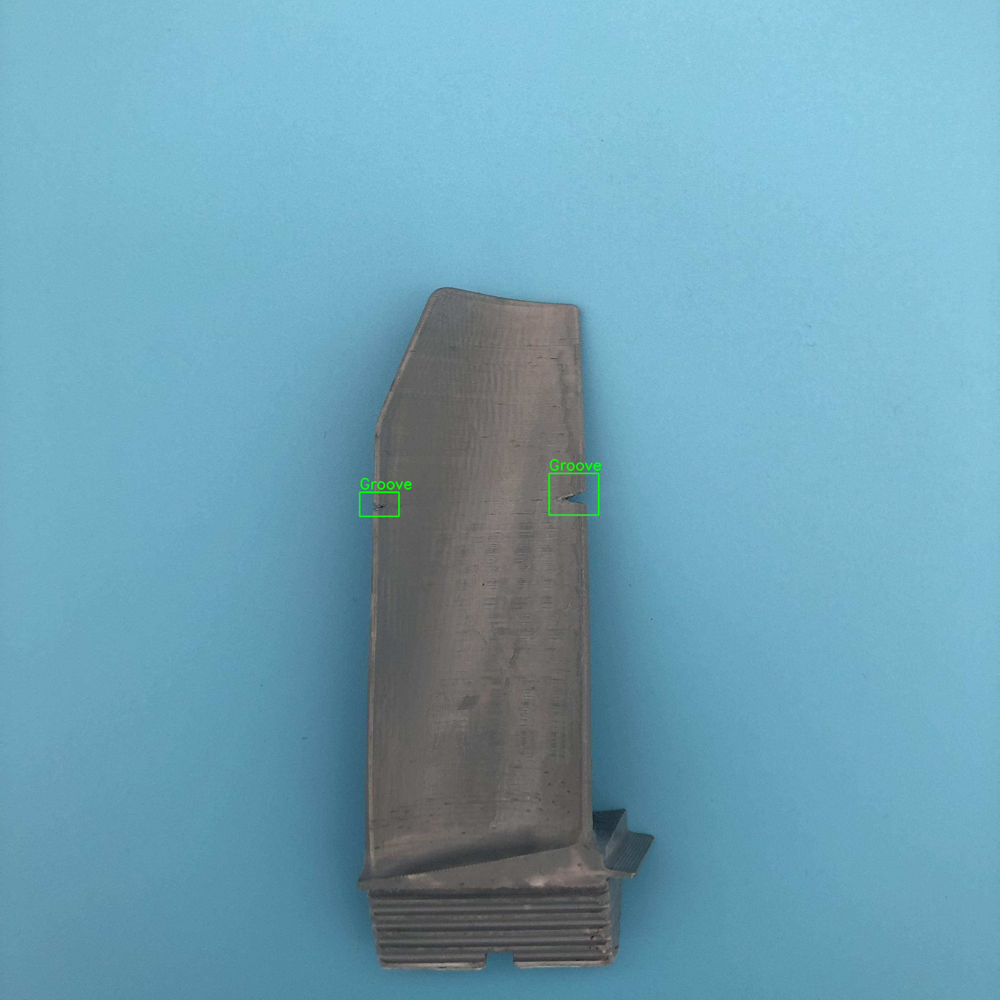

In [18]:
# Детектируем повреждения
start_detection(r'/content/IMG_8256.png')

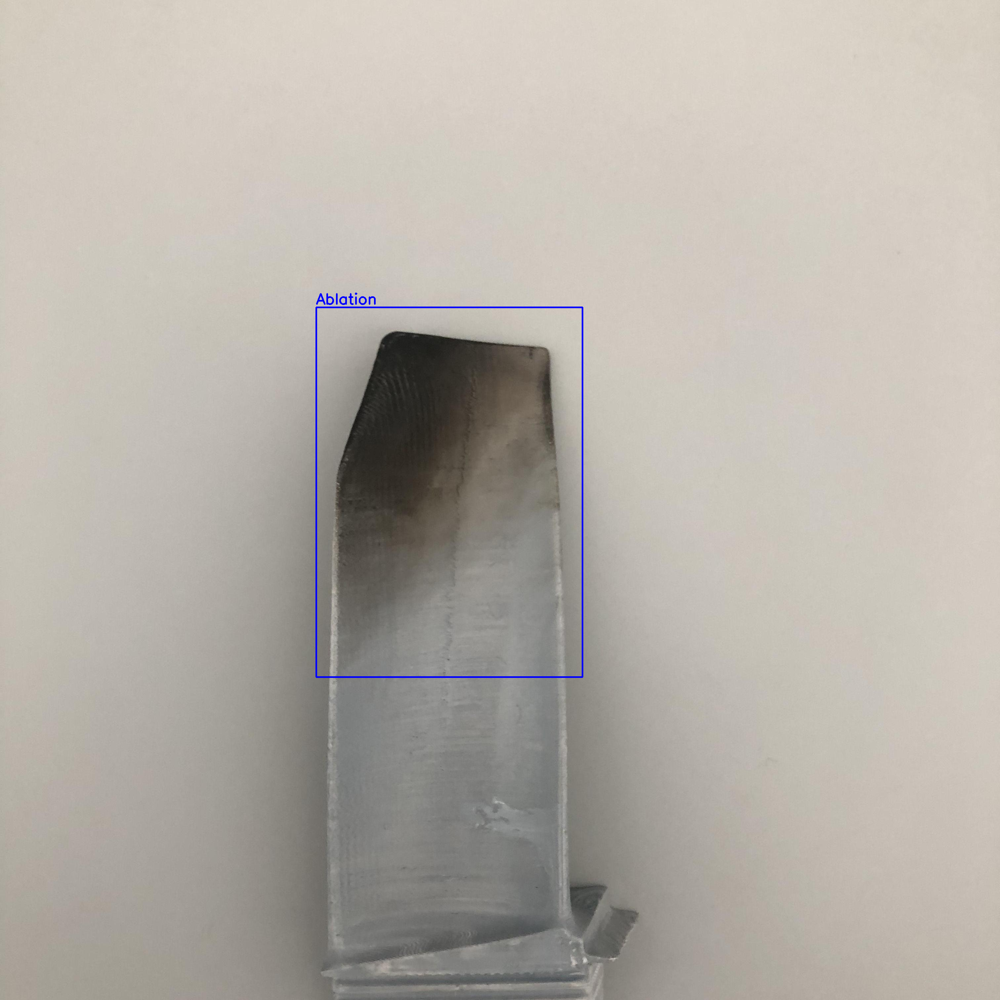

In [19]:
# Детектируем повреждения
start_detection(r'/content/IMG_8786.png')

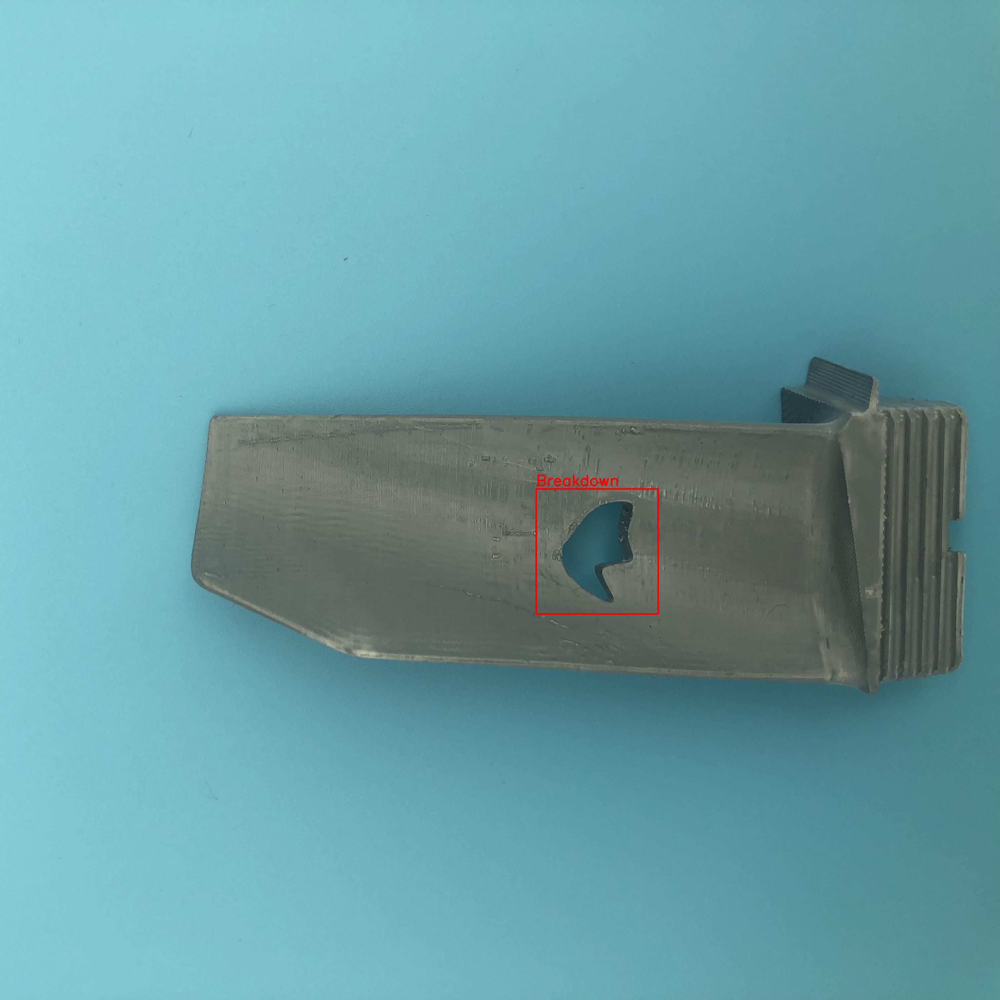

In [22]:
# Детектируем повреждения
start_detection(r'/content/IMG_8988.png')

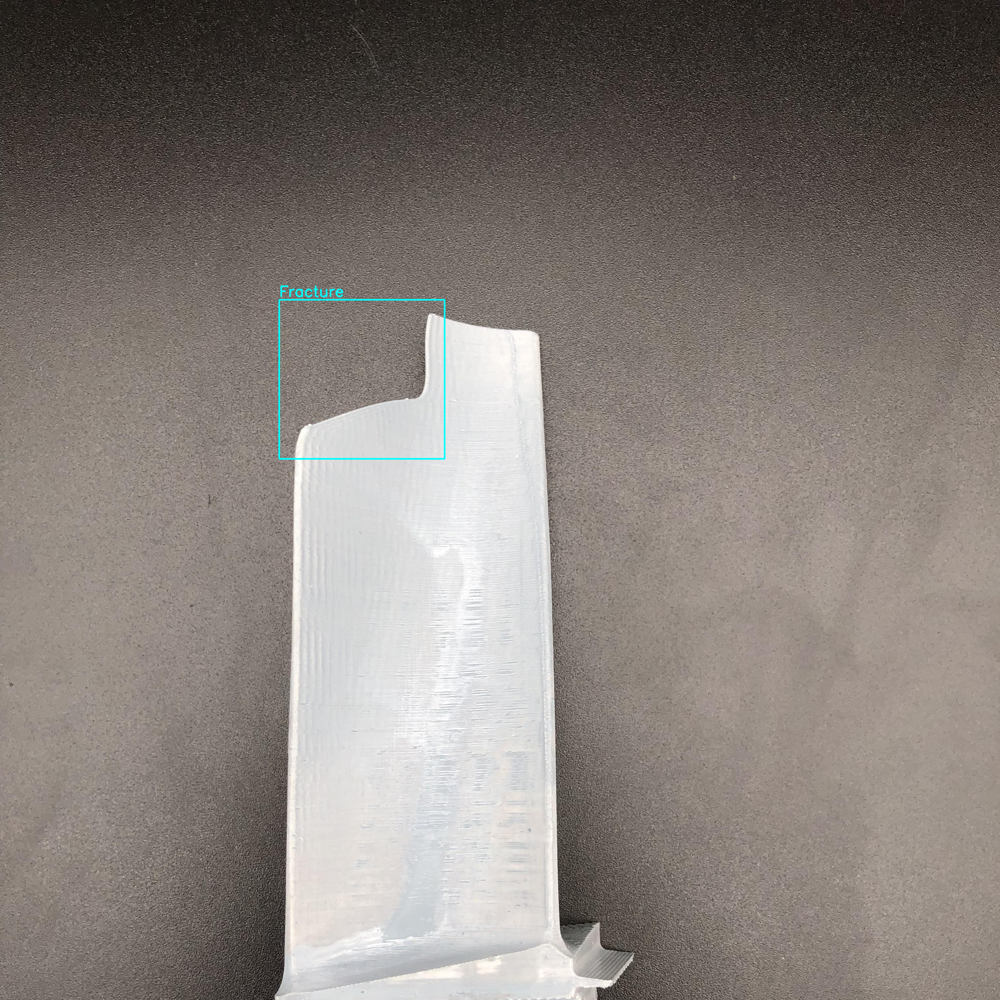

In [25]:
# Детектируем повреждения
start_detection(r'/content/IMG_9405.png')